# 0 환경설정

In [ ]:
import pandas as pd
import numpy as np
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Mounted at /content/drive


In [ ]:
# !pip install transformers fugashi ipadic

# 1 데이터 준비

In [ ]:
total_reviews_topic = pd.read_csv('/content/drive/MyDrive/BA_capstone/data/total_reviews_wTopic2.csv',encoding='utf-8-sig')
total_reviews_topic=total_reviews_topic.dropna(subset='리뷰')
total_reviews_topic =total_reviews_topic[total_reviews_topic['리뷰']!=' ']

total_reviews_topic['y'] = np.where(total_reviews_topic['추천도']>5,1,0)
print(total_reviews_topic.shape)

(35409, 73)


In [ ]:
print(total_reviews_topic.y.value_counts())

0    18705
1    16704
Name: y, dtype: int64


In [ ]:
#resampling 후에 data split
rec_random_idx = total_reviews_topic[total_reviews_topic['y']==1].sample(16704, random_state=8).index.tolist()
unrec_random_idx = total_reviews_topic[total_reviews_topic['y']==0].sample(16704, random_state=8).index.tolist()

from sklearn.model_selection import train_test_split
random_idx = rec_random_idx + unrec_random_idx
X = total_reviews_topic['리뷰'][random_idx]
y = total_reviews_topic['y'][random_idx]

가장 긴 문자열의 길이: 1950
평균 문자열의 길이: 188.69375598659005


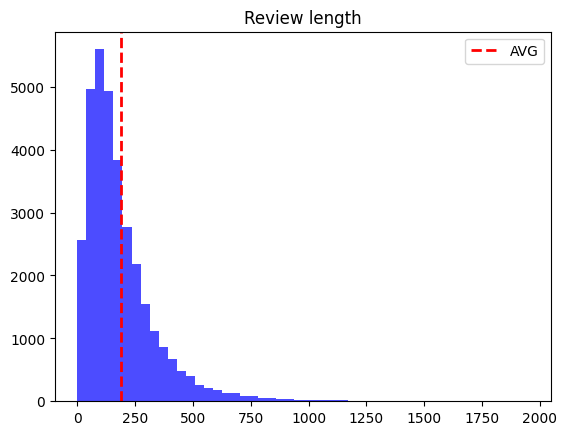

In [ ]:
import matplotlib.pyplot as plt

# 각 문자열의 길이를 저장할 리스트
lengths = [len(x) for x in X]

# 가장 긴 문자열과 그 길이
max_str = max(X, key=len)
max_str_length = len(max_str)

# 평균 길이 계산
average_length = sum(lengths) / len(lengths)

print(f"가장 긴 문자열의 길이: {max_str_length}")
print(f"평균 문자열의 길이: {average_length}")

# 길이 분포 그래프
plt.hist(lengths, bins=50, color='blue', alpha=0.7)
plt.axvline(x=average_length, color='red', linestyle='dashed', linewidth=2, label='AVG')
plt.title('Review length')
plt.legend()
plt.show()

In [ ]:
category_list = y.unique().tolist()
print(category_list)

id_category_list = []
for index, category in enumerate(category_list):
    category_dict = {"id": index, "category": category}
    id_category_list.append(category_dict)
print(id_category_list)

[1, 0]
[{'id': 0, 'category': 1}, {'id': 1, 'category': 0}]


# 2 Dataloader 작성

In [ ]:
import os
import torch
import tensorflow as tf
from torch.utils.data import Dataset, DataLoader
from transformers import BertJapaneseTokenizer
import random

random_seed = 0
torch.manual_seed(random_seed) #이게 원래 설정되어 있던거
torch.cuda.manual_seed(random_seed)
torch.cuda.manual_seed_all(random_seed) # if use multi-GPU
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(random_seed)
random.seed(random_seed)

def set_seeds(seed):
    os.environ['PYTHONHASHSEED'] = str(seed)
    random.seed(seed)
    tf.random.set_seed(seed)
    np.random.seed(seed)

set_seeds(random_seed)

In [ ]:
model_name = "cl-tohoku/bert-base-japanese-whole-word-masking"
tokenizer = BertJapaneseTokenizer.from_pretrained(model_name) #vocab_file=vocab_path

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/110 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/258k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

In [ ]:
import numpy as np
import tensorflow
import torch
from sklearn.model_selection import train_test_split

X_train_reviews, X_test_reviews, y_train, y_test = train_test_split(X, y, test_size=0.3,stratify=y, random_state=42)

X_train_reviews = np.array(X_train_reviews)
X_test_reviews = np.array(X_test_reviews)

# 정수로 변환
y_train = torch.tensor(y_train.values,dtype=torch.long)
y_test =  torch.tensor(y_test.values,dtype=torch.long)

print(X_train_reviews[0])
print(X_train_reviews.shape)
print(y_train[0])
print(len(X_train_reviews),len(X_test_reviews))

高額ですが、翌日、違うと効果できます。特にゆるぎ世代にはオススメです。
(23385,)
tensor(1)
23385 10023


In [ ]:
import torch

def collate_fn(batch):
    input_ids = [item['input_ids'] for item in batch]
    attention_masks = [item['attention_mask'] for item in batch]
    token_type_ids = [item['token_type_ids'] for item in batch]
    labels = [item['label'] for item in batch]

    # Sequence padding to the same length
    input_ids = torch.nn.utils.rnn.pad_sequence(input_ids, batch_first=True, padding_value=0)
    attention_masks = torch.nn.utils.rnn.pad_sequence(attention_masks, batch_first=True, padding_value=0)
    token_type_ids = torch.nn.utils.rnn.pad_sequence(token_type_ids, batch_first=True, padding_value=0)

    return {
        'input_ids': input_ids,
        'attention_mask': attention_masks,
        'token_type_ids': token_type_ids,
        'labels': torch.tensor(labels, dtype=torch.long)
    }

In [ ]:
MAX_SEQUENCE_LEN=512 #####################

from torch.utils.data import Dataset, DataLoader

class MyDataset(Dataset):
    def __init__(self, reviews, labels, tokenizer, max_len=MAX_SEQUENCE_LEN):
        self.reviews = reviews
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.reviews)

    def __getitem__(self, idx):
        review = str(self.reviews[idx])
        label = int(self.labels[idx])

        encoding = self.tokenizer(review, padding=True, truncation=True, max_length=self.max_len, return_tensors='pt')

        return {
            'input_ids': encoding['input_ids'].squeeze(),
            'attention_mask': encoding['attention_mask'].squeeze(),
            'token_type_ids': encoding['token_type_ids'].squeeze(),
            'label': label
        }



# 데이터셋 생성
train_dataset = MyDataset(X_train_reviews, y_train, tokenizer, max_len=MAX_SEQUENCE_LEN)
test_dataset = MyDataset(X_test_reviews, y_test, tokenizer, max_len=MAX_SEQUENCE_LEN)

# DataLoader 생성
train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True, collate_fn=collate_fn)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)

NameError: name 'tokenizer' is not defined

# 3 모델 학습

In [ ]:
#@title **모델 정의 새로 학습시킬때마다 실행 필수**
from transformers import BertForSequenceClassification
model_name = "cl-tohoku/bert-base-japanese-whole-word-masking"
tokenizer = BertJapaneseTokenizer.from_pretrained(model_name) #vocab_file=vocab_path

device = "cuda"
model = BertForSequenceClassification.from_pretrained(model_name, num_labels=2).to(device)

learning_rate = 1e-5
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate) #,weight_decay=weight_decay

pytorch_model.bin:   0%|          | 0.00/445M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at cl-tohoku/bert-base-japanese-whole-word-masking and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


### *기존 튜닝 및 평가함수*

In [ ]:
#@title 함수 정의
# Metric
from sklearn.metrics import f1_score
def macro_f1_score(labels_list, outputs_list):
    return f1_score(labels_list, outputs_list, average='macro')

def test_evaluation(model_path,test_dataloader):
    device = "cuda"
    test_model = BertForSequenceClassification.from_pretrained(model_name, num_labels=2).to(device)

    model_state_dict = torch.load(model_path, map_location=device)
    test_model.load_state_dict(model_state_dict)

    test_model.eval()
    labels_list, outputs_list = [], []
    for i, batch in enumerate(test_dataloader):
        batch = {key: value.to(device) for key, value in batch.items()}
        labels_list = np.concatenate([labels_list, batch["labels"].cpu().detach().numpy()])
        output = test_model(**batch)
        output = output.logits.argmax(axis=1).cpu().detach().numpy()
        outputs_list = np.concatenate([outputs_list, output])

    accuracy = sum(outputs_list == labels_list) / len(outputs_list) * 100
    macro_f1 = macro_f1_score(labels_list, outputs_list)

    print(f"test_accuracy: {round(accuracy, 2)}% {sum(outputs_list == labels_list)}/{len(outputs_list)}, macro f1 score: {round(macro_f1,2)}")

    from sklearn.metrics import classification_report
    print(classification_report(y_true=labels_list, y_pred=outputs_list))

In [ ]:
# @title trainer
from sklearn.metrics import roc_auc_score

def bert_model_trainer(train_dataloader,test_dataloader,EPOCH,train_loss_threshold,patience,save_model_name):
    print(f'EPOCH:{EPOCH},train_loss_threshold:{train_loss_threshold}, patience:{patience}, save_model_name:{save_model_name}')

    EPOCH = EPOCH
    best_accuracy = 0.0
    best_train_loss = float('inf')  # 초기값을 무한대로 설정
    train_loss_threshold = train_loss_threshold
    patience = patience

    # 모델 저장 경로
    model_save_path = f"/content/drive/MyDrive/BA_capstone/data/{save_model_name}.pt"

    for epoch in range(EPOCH):

        model.train()
        train_loss = 0
        for i, batch in enumerate(train_dataloader):
            batch = {key: value.to(device) for key, value in batch.items()}
            output = model(**batch)
            loss = output.loss

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            train_loss += loss

        model.eval()
        labels_list, outputs_list, probabilities_list = [], [], []
        for i, batch in enumerate(test_dataloader):
            batch = {key: value.to(device) for key, value in batch.items()}
            labels_list = np.concatenate([labels_list, batch["labels"].cpu().detach().numpy()])
            output = model(**batch)
            logits = output.logits
            probabilities = torch.softmax(logits, dim=1)
            output = logits.argmax(axis=1).cpu().detach().numpy()
            outputs_list = np.concatenate([outputs_list, output])
            probabilities_list = np.concatenate([probabilities_list, probabilities[:, 1].cpu().detach().numpy()])  # Assuming binary classification

        accuracy = sum(outputs_list == labels_list) / len(outputs_list) * 100
        macro_f1 = macro_f1_score(labels_list, outputs_list)
        auc = roc_auc_score(labels_list, probabilities_list)

        print(f"epoch: {epoch + 1}, train_loss: {round(train_loss.item(), 1)}, test_accuracy: {round(accuracy, 2)}% {sum(outputs_list == labels_list)}/{len(outputs_list)}, macro f1 score: {round(macro_f1, 2)}, AUC: {round(auc, 2)}")

        # Early stopping 및 모델 저장
        if ((best_train_loss - train_loss) > train_loss_threshold and train_loss < best_train_loss) or (accuracy > best_accuracy):
            best_accuracy = accuracy
            best_train_loss = train_loss
            no_improvement_count = 0

            print(f'epoch{epoch + 1} model saved!')
            # 베스트 모델 저장
            torch.save(model.state_dict(), model_save_path)
        else:
            no_improvement_count += 1

        if no_improvement_count >= patience:
            print(f"Early stopping! No improvement for {patience} consecutive epochs.")
            break

### *transformer 튜닝 및 평가함수*

In [ ]:
# #@title transformer trainer
# from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score
# from transformers import TrainingArguments, Trainer
# from transformers import EarlyStoppingCallback

# # Define Trainer parameters
# def compute_metrics(p):
#     pred, labels = p
#     pred = np.argmax(pred, axis=1)

#     accuracy = accuracy_score(y_true=labels, y_pred=pred)
#     recall = recall_score(y_true=labels, y_pred=pred)
#     precision = precision_score(y_true=labels, y_pred=pred)
#     f1 = f1_score(y_true=labels, y_pred=pred)

#     return {"accuracy": accuracy, "precision": precision, "recall": recall, "f1": f1}


# # Define Trainer
# args = TrainingArguments(
#     output_dir="./output",
#     num_train_epochs=50,
#     evaluation_strategy="steps",
#     per_device_train_batch_size=8,
#     per_device_eval_batch_size=8,
#     seed=0,
#     data_seed=0,
#     load_best_model_at_end=True
# )

# trainer = Trainer(
#     model=model,
#     args=args,
#     train_dataset=train_dataset,
#     eval_dataset=val_dataset,
#     compute_metrics=compute_metrics,
#     tokenizer=tokenizer,
#     optimizers=optimizer,
#     callbacks=[EarlyStoppingCallback(early_stopping_patience=5)]
# )

# # Train pre-trained model
# trainer.train()

ValueError: --load_best_model_at_end requires the save and eval strategy to match, but found
- Evaluation strategy: epoch
- Save strategy: steps

In [ ]:
#@title transformer test evaluation
# ----- 3. Predict -----#

from transformers import BertForSequenceClassification
device = "cuda"

# Load trained model
model_path = "./output/checkpoint-50000"
final_model = BertForSequenceClassification.from_pretrained(model_path, num_labels=2).to(device)

# Define test trainer
test_trainer = Trainer(final_model)

# Make prediction
raw_pred, _, _ = test_trainer.predict(test_dataset)

# Preprocess raw predictions
y_pred = np.argmax(raw_pred, axis=1)

accuracy = accuracy_score(y_true=y_test, y_pred=y_pred)
recall = recall_score(y_true=y_test, y_pred=y_pred)
precision = precision_score(y_true=y_test, y_pred=y_pred)
f1 = f1_score(y_true=y_test, y_pred=y_pred)

print(f'test accuracy:{accuracy}, precision:{precision}, recall:{recall}, f1:{f1}')

### 학습

#### 최종 사용 모델 피팅

In [ ]:
#@title bert_model_trainer_불용어 제거 안한 버전
bert_model_trainer(train_dataloader,test_dataloader,40,5,5,'model_512_V1')

EPOCH:40,train_loss_threshold:5, patience:5, save_model_name:model_512_V1
epoch: 1, train_loss: 1709.0, test_accuracy: 71.34% 7150/10023, macro f1 score: 0.71
epoch1 model saved!
epoch: 2, train_loss: 1475.8, test_accuracy: 70.95% 7111/10023, macro f1 score: 0.71
epoch2 model saved!
epoch: 3, train_loss: 1219.7, test_accuracy: 70.08% 7024/10023, macro f1 score: 0.7
epoch3 model saved!
epoch: 4, train_loss: 905.3, test_accuracy: 69.82% 6998/10023, macro f1 score: 0.7
epoch4 model saved!
epoch: 5, train_loss: 615.6, test_accuracy: 69.98% 7014/10023, macro f1 score: 0.7
epoch5 model saved!
epoch: 6, train_loss: 416.9, test_accuracy: 69.29% 6945/10023, macro f1 score: 0.69
epoch6 model saved!
epoch: 7, train_loss: 326.5, test_accuracy: 69.45% 6961/10023, macro f1 score: 0.69
epoch7 model saved!
epoch: 8, train_loss: 243.1, test_accuracy: 68.94% 6910/10023, macro f1 score: 0.69
epoch8 model saved!
epoch: 9, train_loss: 219.3, test_accuracy: 69.29% 6945/10023, macro f1 score: 0.69
epoch9 mod

KeyboardInterrupt: 

In [ ]:
#@title bert_model_trainer_불용어 제거 안한 버전
print('epoch 25부터 이어서!')
bert_model_trainer(train_dataloader,test_dataloader,40,5,5,'model_512_V1')

epoch 25부터 이어서!
EPOCH:40,train_loss_threshold:5, patience:5, save_model_name:model_512_V1
epoch: 1, train_loss: 66.6, test_accuracy: 69.06% 6922/10023, macro f1 score: 0.69, AUC: 0.77
epoch1 model saved!
epoch: 2, train_loss: 77.0, test_accuracy: 68.22% 6838/10023, macro f1 score: 0.68, AUC: 0.77
epoch: 3, train_loss: 60.2, test_accuracy: 69.72% 6988/10023, macro f1 score: 0.7, AUC: 0.77
epoch3 model saved!
epoch: 4, train_loss: 63.3, test_accuracy: 68.87% 6903/10023, macro f1 score: 0.69, AUC: 0.76
epoch: 5, train_loss: 58.1, test_accuracy: 68.4% 6856/10023, macro f1 score: 0.68, AUC: 0.77
epoch: 6, train_loss: 60.4, test_accuracy: 69.49% 6965/10023, macro f1 score: 0.69, AUC: 0.77
epoch: 7, train_loss: 51.5, test_accuracy: 69.52% 6968/10023, macro f1 score: 0.69, AUC: 0.76
epoch7 model saved!
epoch: 8, train_loss: 56.0, test_accuracy: 69.79% 6995/10023, macro f1 score: 0.7, AUC: 0.77
epoch8 model saved!
epoch: 9, train_loss: 50.7, test_accuracy: 69.61% 6977/10023, macro f1 score: 0.7

# 4 모델 로드

In [ ]:
import torch

device = "cuda"
model = BertForSequenceClassification.from_pretrained(model_name, num_labels=2).to(device)

model_state_dict = torch.load("/content/drive/MyDrive/BA_capstone/data/model_512_V1.pt", map_location=device)
model.load_state_dict(model_state_dict)

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at cl-tohoku/bert-base-japanese-whole-word-masking and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


<All keys matched successfully>

In [ ]:
#@title 추천의도 예측함수
import torch.nn.functional as F

def classify_emotion(text):
    # 텍스트 토큰화 및 패딩
    tokens = tokenizer(text, padding='max_length', truncation=True, max_length=MAX_SEQUENCE_LEN, return_tensors="pt").to(device)

    # 예측 수행
    with torch.no_grad():
        prediction = model(**tokens)

    # 예측 결과를 바탕으로 감정 출력
    prediction = F.softmax(prediction.logits, dim=1)
    output = prediction.argmax(dim=1).item()
    if output == 0:
      label = '추천의도 없음'

    if output == 1:
      label = '추천의도 있음'

    print(f'[{label}]')


def predict_sentence():
    input_sentence = input('문장을 입력해 주세요: ')
    classify_emotion(input_sentence)

# 모델을 GPU로 이동
model.to(device)

문장을 입력해 주세요: リピートしました。
[추천의도 있음]


In [ ]:
# 예측 실행
predict_sentence()

문장을 입력해 주세요: とろっとしたテクスチャーなのでコットンを使って拭き取っても摩擦感は少ない気がします。匂いもよくて気に入っています。
[추천의도 있음]


In [ ]:
# 예측 실행
predict_sentence()

문장을 입력해 주세요: 保湿力が良くて冬にぴったりです！乾燥肌の方にオススメです。
[추천의도 없음]


In [ ]:
# 예측 실행
predict_sentence()

문장을 입력해 주세요: この化粧水めっちゃいいです
[추천의도 있음]


In [ ]:
# 예측 실행
predict_sentence()

문장을 입력해 주세요: ニキビができました。
[추천의도 없음]


In [ ]:
# 예측 실행
predict_sentence()

문장을 입력해 주세요: この商品を使ってからニキビができました。
[추천의도 있음]


In [ ]:
# 예측 실행
predict_sentence()

문장을 입력해 주세요: ニキビが悪くなりました。
[추천의도 있음]


In [ ]:
# 예측 실행
predict_sentence()

문장을 입력해 주세요: いい香りがしました。
[추천의도 있음]


In [ ]:
# 예측 실행
predict_sentence()

문장을 입력해 주세요: フローラルの香りで好きです。
[추천의도 없음]


In [ ]:
path = '/content/drive/MyDrive/BA_capstone/data/model_512_V1.pt'
test_evaluation(path,test_dataloader)
#V1 epoch: 39, train_loss: 43.3, test_accuracy: 70.0% 7016/10023, macro f1 score: 0.7, AUC: 0.77

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at cl-tohoku/bert-base-japanese-whole-word-masking and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


test_accuracy: 70.0% 7016/10023, macro f1 score: 0.7
              precision    recall  f1-score   support

         0.0       0.73      0.63      0.68      5012
         1.0       0.67      0.77      0.72      5011

    accuracy                           0.70     10023
   macro avg       0.70      0.70      0.70     10023
weighted avg       0.70      0.70      0.70     10023



# 5 shap

## shap value 계산 후 저장

In [ ]:
# !pip install shap

In [ ]:
torch.cuda.empty_cache()

In [ ]:
from transformers import BertForSequenceClassification

device = "cuda"
model = BertForSequenceClassification.from_pretrained(model_name, num_labels=2).to(device)
model_state_dict = torch.load("/content/drive/MyDrive/BA_capstone/data/model_512_V1.pt", map_location=device)
model.load_state_dict(model_state_dict)

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at cl-tohoku/bert-base-japanese-whole-word-masking and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


<All keys matched successfully>

In [ ]:
import shap
import numpy as np
import torch
import scipy as sp
from torch.utils.data import DataLoader
import joblib

# define a prediction function
def f(x):
    tv = torch.tensor(
        [
            tokenizer.encode(v, padding="max_length", max_length=MAX_SEQUENCE_LEN, truncation=True)
            for v in x
        ]
    ).cuda()
    outputs = model(tv)[0].detach().cpu().numpy()
    scores = (np.exp(outputs).T / np.exp(outputs).sum(-1)).T
    val = sp.special.logit(scores[:, 1])  # use one vs rest logit units
    return val


# shap.Explainer 생성
explainer = shap.Explainer(f, tokenizer,seed=10)
shap_values = explainer(X_test_reviews, fixed_context=1) #####


# SHAP 값을 joblib을 사용하여 저장
joblib.dump(shap_values, '/content/drive/MyDrive/BA_capstone/shap_values_bert.joblib')

We strongly recommend passing in an `attention_mask` since your input_ids may be padded. See https://huggingface.co/docs/transformers/troubleshooting#incorrect-output-when-padding-tokens-arent-masked.
PartitionExplainer explainer:   0%|          | 8/10023 [00:12<2:17:38,  1.21it/s]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   0%|          | 10/10023 [00:20<6:45:36,  2.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   0%|          | 13/10023 [00:29<7:37:12,  2.74s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   0%|          | 22/10023 [00:53<6:40:18,  2.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   0%|          | 33/10023 [01:17<6:44:23,  2.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   0%|          | 38/10023 [01:32<8:05:50,  2.92s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   0%|          | 47/10023 [01:55<5:39:32,  2.04s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|          | 53/10023 [02:08<4:11:25,  1.51s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|          | 55/10023 [02:14<5:36:49,  2.03s/it]Token indices sequence length is longer than the specified maximum sequence length for this model (644 > 512). Running this sequence through the model will result in indexing errors


  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|          | 64/10023 [02:42<9:16:03,  3.35s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|          | 68/10023 [02:55<7:44:15,  2.80s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|          | 69/10023 [03:01<10:14:27,  3.70s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|          | 72/10023 [03:10<7:36:02,  2.75s/it] 

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|          | 73/10023 [03:16<10:22:15,  3.75s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|          | 124/10023 [04:50<3:05:27,  1.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|          | 125/10023 [04:56<7:37:24,  2.77s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|▏         | 134/10023 [05:15<5:57:16,  2.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|▏         | 136/10023 [05:27<10:24:15,  3.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|▏         | 138/10023 [05:33<8:44:50,  3.19s/it] 

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|▏         | 141/10023 [05:46<10:41:06,  3.89s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|▏         | 144/10023 [05:55<8:01:32,  2.92s/it] 

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   1%|▏         | 147/10023 [06:08<9:41:32,  3.53s/it] 

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 154/10023 [06:24<5:35:00,  2.04s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 159/10023 [06:37<5:42:58,  2.09s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 187/10023 [07:37<5:40:18,  2.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 199/10023 [08:09<5:56:48,  2.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 201/10023 [08:18<8:38:38,  3.17s/it] 

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 206/10023 [08:31<6:15:31,  2.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 208/10023 [08:38<6:56:52,  2.55s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 210/10023 [08:46<8:22:49,  3.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 211/10023 [08:52<10:40:21,  3.92s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 223/10023 [09:18<4:24:33,  1.62s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 225/10023 [09:27<8:18:58,  3.06s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 229/10023 [09:37<5:37:12,  2.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 232/10023 [09:45<6:18:54,  2.32s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 245/10023 [10:13<6:28:12,  2.38s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   2%|▏         | 246/10023 [10:21<10:49:52,  3.99s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   3%|▎         | 259/10023 [10:53<6:38:56,  2.45s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   3%|▎         | 263/10023 [11:03<4:51:30,  1.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   3%|▎         | 272/10023 [11:18<3:54:14,  1.44s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   3%|▎         | 277/10023 [11:34<6:45:57,  2.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   3%|▎         | 282/10023 [11:49<5:43:36,  2.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   3%|▎         | 308/10023 [12:45<5:12:41,  1.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   3%|▎         | 326/10023 [13:27<5:31:51,  2.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   3%|▎         | 329/10023 [13:38<7:22:48,  2.74s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   3%|▎         | 338/10023 [14:04<7:07:29,  2.65s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▎         | 353/10023 [14:41<3:50:31,  1.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▎         | 355/10023 [14:47<5:37:51,  2.10s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▎         | 361/10023 [15:05<6:16:13,  2.34s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▍         | 377/10023 [15:46<7:10:03,  2.68s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▍         | 403/10023 [16:40<3:00:08,  1.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▍         | 405/10023 [16:51<8:47:46,  3.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▍         | 407/10023 [16:59<8:49:03,  3.30s/it] 

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▍         | 408/10023 [17:05<11:21:39,  4.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▍         | 410/10023 [17:16<12:51:47,  4.82s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▍         | 420/10023 [17:49<10:06:41,  3.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▍         | 427/10023 [18:14<8:20:23,  3.13s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▍         | 428/10023 [18:19<10:21:28,  3.89s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▍         | 434/10023 [18:36<5:38:27,  2.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▍         | 443/10023 [18:59<6:54:59,  2.60s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▍         | 448/10023 [19:20<9:19:51,  3.51s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   4%|▍         | 450/10023 [19:26<8:22:36,  3.15s/it] 

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   5%|▍         | 456/10023 [19:42<5:06:32,  1.92s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   5%|▍         | 459/10023 [19:51<6:13:30,  2.34s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   5%|▍         | 469/10023 [20:12<4:13:33,  1.59s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   5%|▍         | 478/10023 [20:32<4:07:28,  1.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   5%|▍         | 486/10023 [20:49<4:31:48,  1.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   5%|▍         | 493/10023 [21:10<7:43:58,  2.92s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   5%|▍         | 498/10023 [21:29<7:56:14,  3.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   5%|▌         | 509/10023 [21:44<2:16:06,  1.16it/s]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   5%|▌         | 511/10023 [21:51<5:00:31,  1.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   5%|▌         | 517/10023 [22:06<5:28:29,  2.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   5%|▌         | 524/10023 [22:22<4:56:36,  1.87s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   5%|▌         | 541/10023 [23:00<4:43:04,  1.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   5%|▌         | 543/10023 [23:09<8:05:56,  3.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   5%|▌         | 549/10023 [23:25<6:53:26,  2.62s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   6%|▌         | 566/10023 [24:12<5:16:57,  2.01s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   6%|▌         | 578/10023 [24:38<5:27:09,  2.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   6%|▌         | 601/10023 [25:38<4:07:32,  1.58s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   6%|▌         | 604/10023 [25:49<6:50:47,  2.62s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   6%|▌         | 615/10023 [26:23<7:51:26,  3.01s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   6%|▌         | 625/10023 [26:46<4:29:36,  1.72s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   6%|▋         | 628/10023 [26:55<5:31:31,  2.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   6%|▋         | 638/10023 [27:21<5:12:46,  2.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   6%|▋         | 648/10023 [27:44<5:33:59,  2.14s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   7%|▋         | 654/10023 [28:06<8:42:25,  3.35s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   7%|▋         | 658/10023 [28:15<5:15:05,  2.02s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   7%|▋         | 666/10023 [28:39<6:52:51,  2.65s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   7%|▋         | 678/10023 [29:02<3:55:13,  1.51s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   7%|▋         | 689/10023 [29:27<5:31:43,  2.13s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   7%|▋         | 701/10023 [30:02<6:04:44,  2.35s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   7%|▋         | 702/10023 [30:08<8:59:44,  3.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   7%|▋         | 707/10023 [30:27<7:17:03,  2.81s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   7%|▋         | 710/10023 [30:38<8:06:27,  3.13s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   7%|▋         | 717/10023 [30:58<5:24:37,  2.09s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   7%|▋         | 742/10023 [32:07<4:24:25,  1.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   7%|▋         | 745/10023 [32:16<5:55:32,  2.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   7%|▋         | 750/10023 [32:30<6:13:52,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   8%|▊         | 754/10023 [32:42<6:16:58,  2.44s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   8%|▊         | 763/10023 [33:04<4:40:35,  1.82s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   8%|▊         | 774/10023 [33:30<5:33:19,  2.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   8%|▊         | 790/10023 [34:10<4:26:37,  1.73s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   8%|▊         | 805/10023 [34:40<5:48:46,  2.27s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   8%|▊         | 828/10023 [35:41<4:32:43,  1.78s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   8%|▊         | 841/10023 [36:12<4:50:24,  1.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▊         | 863/10023 [37:05<6:21:35,  2.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▊         | 865/10023 [37:15<9:15:28,  3.64s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▊         | 869/10023 [37:31<7:50:12,  3.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▉         | 883/10023 [37:54<3:35:49,  1.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▉         | 886/10023 [38:02<5:05:35,  2.01s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▉         | 887/10023 [38:08<7:37:11,  3.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▉         | 892/10023 [38:24<7:54:55,  3.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▉         | 896/10023 [38:38<7:33:56,  2.98s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▉         | 898/10023 [38:47<9:01:33,  3.56s/it] 

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▉         | 914/10023 [39:24<4:17:41,  1.70s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▉         | 920/10023 [39:44<6:52:10,  2.72s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▉         | 923/10023 [39:58<8:32:03,  3.38s/it] 

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▉         | 932/10023 [40:18<4:40:51,  1.85s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▉         | 935/10023 [40:28<6:16:09,  2.48s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:   9%|▉         | 943/10023 [40:54<6:22:32,  2.53s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|▉         | 968/10023 [41:43<4:36:27,  1.83s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|▉         | 978/10023 [42:08<4:49:10,  1.92s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|▉         | 986/10023 [42:28<4:30:53,  1.80s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|▉         | 988/10023 [42:35<6:26:23,  2.57s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|▉         | 991/10023 [42:43<5:45:02,  2.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|▉         | 992/10023 [42:49<8:28:22,  3.38s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|▉         | 993/10023 [42:55<10:28:18,  4.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|▉         | 995/10023 [43:02<8:55:40,  3.56s/it] 

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|▉         | 996/10023 [43:07<10:11:20,  4.06s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|▉         | 998/10023 [43:17<10:53:12,  4.34s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|█         | 1004/10023 [43:35<6:24:10,  2.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|█         | 1014/10023 [43:54<4:03:33,  1.62s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|█         | 1021/10023 [44:16<7:16:13,  2.91s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|█         | 1033/10023 [44:49<7:59:09,  3.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|█         | 1034/10023 [44:56<10:16:25,  4.11s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|█         | 1037/10023 [45:07<8:30:59,  3.41s/it] 

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|█         | 1049/10023 [45:41<6:42:41,  2.69s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  11%|█         | 1057/10023 [46:02<5:42:38,  2.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  11%|█         | 1059/10023 [46:10<7:20:03,  2.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  11%|█         | 1066/10023 [46:25<4:42:18,  1.89s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  11%|█         | 1068/10023 [46:34<7:46:02,  3.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  11%|█         | 1069/10023 [46:40<9:50:02,  3.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  11%|█         | 1071/10023 [46:47<9:12:27,  3.70s/it] 

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  11%|█         | 1075/10023 [46:57<5:45:37,  2.32s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  11%|█         | 1108/10023 [48:01<4:49:28,  1.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  12%|█▏        | 1183/10023 [50:18<4:57:26,  2.02s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  12%|█▏        | 1186/10023 [50:26<4:45:09,  1.94s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  12%|█▏        | 1193/10023 [50:43<4:40:08,  1.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  12%|█▏        | 1200/10023 [51:07<7:38:42,  3.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  12%|█▏        | 1203/10023 [51:14<5:43:34,  2.34s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  12%|█▏        | 1206/10023 [51:23<5:23:18,  2.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  12%|█▏        | 1207/10023 [51:30<8:58:58,  3.67s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  12%|█▏        | 1214/10023 [51:53<8:18:23,  3.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  12%|█▏        | 1229/10023 [52:30<4:05:46,  1.68s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  12%|█▏        | 1233/10023 [52:50<8:43:10,  3.57s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  12%|█▏        | 1237/10023 [52:59<5:31:00,  2.26s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  13%|█▎        | 1256/10023 [53:40<3:45:22,  1.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  13%|█▎        | 1261/10023 [53:55<5:48:46,  2.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  13%|█▎        | 1264/10023 [54:04<5:58:53,  2.46s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  13%|█▎        | 1273/10023 [54:27<5:02:14,  2.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  13%|█▎        | 1279/10023 [54:44<6:13:39,  2.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  13%|█▎        | 1293/10023 [55:13<4:10:42,  1.72s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  13%|█▎        | 1302/10023 [55:36<4:41:16,  1.94s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  13%|█▎        | 1307/10023 [55:48<5:02:42,  2.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  13%|█▎        | 1318/10023 [56:22<6:54:21,  2.86s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  13%|█▎        | 1329/10023 [56:43<3:22:30,  1.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  14%|█▎        | 1371/10023 [58:24<5:54:53,  2.46s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  14%|█▍        | 1380/10023 [58:44<4:43:25,  1.97s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  14%|█▍        | 1384/10023 [58:55<5:01:11,  2.09s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  14%|█▍        | 1392/10023 [59:11<3:32:20,  1.48s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  14%|█▍        | 1403/10023 [59:37<5:18:22,  2.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  14%|█▍        | 1424/10023 [1:00:22<4:17:25,  1.80s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  14%|█▍        | 1436/10023 [1:00:51<6:13:45,  2.61s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  15%|█▍        | 1472/10023 [1:02:02<4:34:51,  1.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  15%|█▍        | 1474/10023 [1:02:11<6:52:23,  2.89s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  15%|█▍        | 1475/10023 [1:02:17<9:08:22,  3.85s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  15%|█▍        | 1477/10023 [1:02:27<10:50:41,  4.57s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  15%|█▍        | 1492/10023 [1:02:56<4:41:38,  1.98s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  15%|█▍        | 1500/10023 [1:03:15<4:50:55,  2.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  15%|█▌        | 1504/10023 [1:03:23<4:18:54,  1.82s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  15%|█▌        | 1506/10023 [1:03:30<5:44:10,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  15%|█▌        | 1524/10023 [1:04:11<3:41:43,  1.57s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  15%|█▌        | 1526/10023 [1:04:18<5:12:55,  2.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  15%|█▌        | 1534/10023 [1:04:38<4:22:49,  1.86s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  15%|█▌        | 1545/10023 [1:05:09<5:05:32,  2.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  16%|█▌        | 1555/10023 [1:05:28<4:17:48,  1.83s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  16%|█▌        | 1572/10023 [1:06:10<4:04:04,  1.73s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  16%|█▌        | 1590/10023 [1:06:55<5:49:37,  2.49s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  16%|█▌        | 1597/10023 [1:07:13<5:02:58,  2.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  16%|█▌        | 1598/10023 [1:07:18<7:09:49,  3.06s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  16%|█▌        | 1603/10023 [1:07:38<7:43:17,  3.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  16%|█▌        | 1606/10023 [1:07:47<6:12:33,  2.66s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  16%|█▌        | 1610/10023 [1:08:00<6:54:43,  2.96s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  16%|█▌        | 1615/10023 [1:08:19<7:24:52,  3.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  16%|█▋        | 1638/10023 [1:09:16<5:36:48,  2.41s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  16%|█▋        | 1650/10023 [1:09:48<4:20:38,  1.87s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  16%|█▋        | 1652/10023 [1:09:56<6:26:15,  2.77s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1655/10023 [1:10:11<9:17:22,  4.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1656/10023 [1:10:17<10:24:06,  4.48s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1658/10023 [1:10:24<8:29:33,  3.65s/it] 

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1666/10023 [1:10:42<4:01:50,  1.74s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1670/10023 [1:10:54<5:04:04,  2.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1682/10023 [1:11:17<2:40:35,  1.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1689/10023 [1:11:35<4:55:05,  2.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1694/10023 [1:11:49<5:41:21,  2.46s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1699/10023 [1:12:05<6:00:42,  2.60s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1706/10023 [1:12:27<6:17:08,  2.72s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1708/10023 [1:12:36<7:49:26,  3.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1710/10023 [1:12:43<7:22:49,  3.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1721/10023 [1:13:07<4:39:45,  2.02s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1723/10023 [1:13:17<8:26:17,  3.66s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1724/10023 [1:13:24<10:09:52,  4.41s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1725/10023 [1:13:29<10:52:05,  4.72s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1741/10023 [1:14:00<3:52:33,  1.68s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  17%|█▋        | 1751/10023 [1:14:23<4:59:45,  2.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  18%|█▊        | 1768/10023 [1:14:53<4:36:50,  2.01s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  18%|█▊        | 1777/10023 [1:15:12<4:06:38,  1.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  18%|█▊        | 1781/10023 [1:15:26<5:53:51,  2.58s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  18%|█▊        | 1801/10023 [1:16:08<2:50:45,  1.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  18%|█▊        | 1831/10023 [1:17:16<5:13:11,  2.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  18%|█▊        | 1835/10023 [1:17:32<7:21:52,  3.24s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  18%|█▊        | 1839/10023 [1:17:43<5:48:09,  2.55s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  19%|█▊        | 1855/10023 [1:18:21<5:48:30,  2.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  19%|█▉        | 1880/10023 [1:19:17<5:01:59,  2.23s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  19%|█▉        | 1881/10023 [1:19:23<7:59:53,  3.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  19%|█▉        | 1901/10023 [1:20:11<4:47:44,  2.13s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  19%|█▉        | 1915/10023 [1:20:44<4:50:19,  2.15s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  19%|█▉        | 1918/10023 [1:20:55<6:17:06,  2.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  19%|█▉        | 1922/10023 [1:21:10<7:56:03,  3.53s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  19%|█▉        | 1926/10023 [1:21:21<5:28:14,  2.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  19%|█▉        | 1945/10023 [1:22:07<4:52:20,  2.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  20%|█▉        | 1971/10023 [1:22:48<3:52:05,  1.73s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  20%|█▉        | 1991/10023 [1:23:34<4:06:46,  1.84s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  20%|█▉        | 1995/10023 [1:23:45<4:55:39,  2.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  20%|██        | 2014/10023 [1:24:31<5:06:48,  2.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  20%|██        | 2019/10023 [1:24:44<4:48:08,  2.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  20%|██        | 2043/10023 [1:25:27<3:56:45,  1.78s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  21%|██        | 2062/10023 [1:26:12<2:28:50,  1.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  21%|██        | 2065/10023 [1:26:23<5:20:36,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  21%|██        | 2070/10023 [1:26:37<5:08:49,  2.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  21%|██        | 2081/10023 [1:27:01<5:26:59,  2.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  21%|██        | 2089/10023 [1:27:21<4:39:05,  2.11s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  21%|██        | 2090/10023 [1:27:27<7:09:53,  3.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  21%|██        | 2091/10023 [1:27:33<9:21:33,  4.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  21%|██        | 2096/10023 [1:27:47<6:19:42,  2.87s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  21%|██        | 2103/10023 [1:28:02<3:33:06,  1.61s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  21%|██        | 2110/10023 [1:28:21<4:20:17,  1.97s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  21%|██        | 2117/10023 [1:28:37<2:48:11,  1.28s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  21%|██▏       | 2131/10023 [1:29:03<3:37:37,  1.65s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  22%|██▏       | 2160/10023 [1:30:01<4:22:47,  2.01s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  22%|██▏       | 2164/10023 [1:30:15<4:43:13,  2.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  22%|██▏       | 2179/10023 [1:30:48<4:57:09,  2.27s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  22%|██▏       | 2181/10023 [1:30:55<5:45:26,  2.64s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  22%|██▏       | 2191/10023 [1:31:23<3:51:41,  1.77s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  22%|██▏       | 2197/10023 [1:31:37<3:58:53,  1.83s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  22%|██▏       | 2198/10023 [1:31:43<6:43:04,  3.09s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  22%|██▏       | 2203/10023 [1:31:59<6:23:28,  2.94s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  22%|██▏       | 2207/10023 [1:32:09<4:30:39,  2.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  22%|██▏       | 2210/10023 [1:32:20<5:50:13,  2.69s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  22%|██▏       | 2216/10023 [1:32:34<4:13:33,  1.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  22%|██▏       | 2228/10023 [1:33:02<3:02:08,  1.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  22%|██▏       | 2244/10023 [1:33:45<3:10:14,  1.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  23%|██▎       | 2262/10023 [1:34:20<3:30:13,  1.63s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  23%|██▎       | 2266/10023 [1:34:29<3:58:42,  1.85s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  23%|██▎       | 2302/10023 [1:36:00<6:11:42,  2.89s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  23%|██▎       | 2306/10023 [1:36:09<4:20:10,  2.02s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  23%|██▎       | 2316/10023 [1:36:30<4:43:01,  2.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  23%|██▎       | 2319/10023 [1:36:42<6:05:17,  2.84s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  23%|██▎       | 2325/10023 [1:36:57<4:56:38,  2.31s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  23%|██▎       | 2334/10023 [1:37:25<6:05:20,  2.85s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  23%|██▎       | 2338/10023 [1:37:38<5:58:06,  2.80s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  23%|██▎       | 2343/10023 [1:37:50<4:26:52,  2.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  23%|██▎       | 2344/10023 [1:37:56<6:49:32,  3.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  23%|██▎       | 2351/10023 [1:38:15<5:17:32,  2.48s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  23%|██▎       | 2354/10023 [1:38:29<8:01:47,  3.77s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  24%|██▎       | 2370/10023 [1:39:00<3:26:17,  1.62s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  24%|██▍       | 2412/10023 [1:40:38<5:03:29,  2.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  24%|██▍       | 2413/10023 [1:40:44<7:21:02,  3.48s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  24%|██▍       | 2423/10023 [1:41:08<4:28:33,  2.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  25%|██▍       | 2486/10023 [1:43:23<4:13:30,  2.02s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  25%|██▍       | 2493/10023 [1:43:44<4:42:10,  2.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  25%|██▍       | 2494/10023 [1:43:50<6:56:30,  3.32s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  25%|██▍       | 2502/10023 [1:44:08<3:41:52,  1.77s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  25%|██▌       | 2508/10023 [1:44:28<6:34:10,  3.15s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  25%|██▌       | 2517/10023 [1:44:49<3:42:39,  1.78s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  25%|██▌       | 2519/10023 [1:44:56<4:58:40,  2.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  25%|██▌       | 2526/10023 [1:45:18<5:02:17,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  25%|██▌       | 2550/10023 [1:46:01<4:40:00,  2.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  25%|██▌       | 2555/10023 [1:46:16<5:29:30,  2.65s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  26%|██▌       | 2556/10023 [1:46:21<7:04:46,  3.41s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  26%|██▌       | 2577/10023 [1:47:11<5:05:04,  2.46s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  26%|██▌       | 2582/10023 [1:47:25<4:31:41,  2.19s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  26%|██▌       | 2583/10023 [1:47:31<6:53:26,  3.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  26%|██▌       | 2592/10023 [1:47:57<4:52:56,  2.37s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  26%|██▌       | 2600/10023 [1:48:23<6:05:18,  2.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  26%|██▌       | 2603/10023 [1:48:35<6:29:57,  3.15s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  26%|██▌       | 2608/10023 [1:48:51<6:10:54,  3.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  26%|██▌       | 2615/10023 [1:49:06<3:27:20,  1.68s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  26%|██▌       | 2624/10023 [1:49:28<4:54:48,  2.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  26%|██▌       | 2625/10023 [1:49:35<7:23:02,  3.59s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  26%|██▋       | 2649/10023 [1:50:28<5:03:44,  2.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  27%|██▋       | 2677/10023 [1:51:34<4:45:43,  2.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  27%|██▋       | 2690/10023 [1:51:54<2:08:54,  1.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  27%|██▋       | 2699/10023 [1:52:14<3:51:02,  1.89s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  27%|██▋       | 2710/10023 [1:52:39<3:01:16,  1.49s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  27%|██▋       | 2712/10023 [1:52:48<5:47:05,  2.85s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  27%|██▋       | 2715/10023 [1:52:56<5:04:09,  2.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  27%|██▋       | 2716/10023 [1:53:05<8:46:45,  4.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  27%|██▋       | 2738/10023 [1:53:49<3:24:53,  1.69s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2765/10023 [1:54:51<5:10:35,  2.57s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2777/10023 [1:55:20<5:09:18,  2.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2779/10023 [1:55:27<5:39:15,  2.81s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2789/10023 [1:55:51<4:49:40,  2.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2795/10023 [1:56:09<5:10:53,  2.58s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2796/10023 [1:56:15<7:15:57,  3.62s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2805/10023 [1:56:36<4:39:13,  2.32s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2808/10023 [1:56:47<6:11:20,  3.09s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2817/10023 [1:57:09<4:10:27,  2.09s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2825/10023 [1:57:33<5:31:53,  2.77s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2833/10023 [1:57:57<5:04:15,  2.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2839/10023 [1:58:13<4:55:45,  2.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2843/10023 [1:58:25<4:43:20,  2.37s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2844/10023 [1:58:31<6:49:46,  3.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2845/10023 [1:58:37<8:17:56,  4.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  28%|██▊       | 2852/10023 [1:58:59<6:10:24,  3.10s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  29%|██▊       | 2861/10023 [1:59:17<3:04:13,  1.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  29%|██▊       | 2874/10023 [1:59:40<3:01:45,  1.53s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  29%|██▊       | 2878/10023 [1:59:56<6:02:27,  3.04s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  29%|██▉       | 2882/10023 [2:00:06<4:49:02,  2.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  29%|██▉       | 2911/10023 [2:01:19<5:20:48,  2.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  29%|██▉       | 2919/10023 [2:01:45<4:55:30,  2.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  29%|██▉       | 2926/10023 [2:01:59<3:23:45,  1.72s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  29%|██▉       | 2928/10023 [2:02:06<4:49:41,  2.45s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  29%|██▉       | 2932/10023 [2:02:15<4:12:10,  2.13s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  29%|██▉       | 2940/10023 [2:02:41<4:34:53,  2.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  29%|██▉       | 2941/10023 [2:02:47<6:57:49,  3.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  29%|██▉       | 2945/10023 [2:03:01<5:58:11,  3.04s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  29%|██▉       | 2947/10023 [2:03:08<6:05:38,  3.10s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  29%|██▉       | 2949/10023 [2:03:15<5:50:33,  2.97s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|██▉       | 2958/10023 [2:03:40<4:53:46,  2.49s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|██▉       | 2959/10023 [2:03:45<6:31:34,  3.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|██▉       | 2965/10023 [2:04:03<5:05:12,  2.59s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|██▉       | 2966/10023 [2:04:10<7:18:42,  3.73s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|██▉       | 2967/10023 [2:04:18<10:14:25,  5.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|██▉       | 2975/10023 [2:04:36<3:42:59,  1.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|██▉       | 2981/10023 [2:04:54<4:33:21,  2.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|██▉       | 2994/10023 [2:05:32<4:46:29,  2.45s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|██▉       | 2996/10023 [2:05:39<5:12:35,  2.67s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|███       | 3029/10023 [2:06:42<4:04:32,  2.10s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|███       | 3039/10023 [2:07:04<3:22:48,  1.74s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|███       | 3041/10023 [2:07:11<4:41:23,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|███       | 3042/10023 [2:07:17<6:39:24,  3.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|███       | 3051/10023 [2:07:41<5:48:09,  3.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|███       | 3056/10023 [2:07:55<4:35:29,  2.37s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  31%|███       | 3062/10023 [2:08:13<4:36:27,  2.38s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  31%|███       | 3068/10023 [2:08:33<5:31:06,  2.86s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  31%|███       | 3071/10023 [2:08:44<6:03:43,  3.14s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  31%|███       | 3077/10023 [2:09:00<4:38:10,  2.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  31%|███       | 3078/10023 [2:09:06<6:19:42,  3.28s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  31%|███       | 3081/10023 [2:09:19<7:35:32,  3.94s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  31%|███       | 3084/10023 [2:09:29<5:58:31,  3.10s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  31%|███       | 3090/10023 [2:09:48<4:41:28,  2.44s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  31%|███       | 3103/10023 [2:10:18<3:20:57,  1.74s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  31%|███       | 3122/10023 [2:10:58<3:58:05,  2.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  31%|███▏      | 3149/10023 [2:12:04<4:57:14,  2.59s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  31%|███▏      | 3151/10023 [2:12:14<6:49:41,  3.58s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  31%|███▏      | 3157/10023 [2:12:27<4:25:03,  2.32s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3174/10023 [2:13:04<2:52:32,  1.51s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3188/10023 [2:13:34<4:22:16,  2.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3189/10023 [2:13:39<6:15:21,  3.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3199/10023 [2:14:06<4:06:26,  2.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3206/10023 [2:14:29<4:52:25,  2.57s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3209/10023 [2:14:40<5:57:58,  3.15s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3211/10023 [2:14:49<7:23:11,  3.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3220/10023 [2:15:16<4:34:26,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3239/10023 [2:15:54<3:55:21,  2.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3240/10023 [2:16:01<6:23:00,  3.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3243/10023 [2:16:11<5:43:20,  3.04s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3247/10023 [2:16:25<5:27:24,  2.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3248/10023 [2:16:31<7:10:13,  3.81s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3252/10023 [2:16:46<7:08:10,  3.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3255/10023 [2:16:57<6:43:06,  3.57s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  32%|███▏      | 3257/10023 [2:17:07<7:00:17,  3.73s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3263/10023 [2:17:19<3:18:25,  1.76s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3270/10023 [2:17:38<3:25:01,  1.82s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3277/10023 [2:17:55<4:09:41,  2.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3279/10023 [2:18:00<4:32:12,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3281/10023 [2:18:11<6:52:01,  3.67s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3298/10023 [2:18:46<3:47:12,  2.03s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3310/10023 [2:19:06<2:19:11,  1.24s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3315/10023 [2:19:16<3:04:42,  1.65s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3325/10023 [2:19:43<4:39:54,  2.51s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3328/10023 [2:19:51<4:22:35,  2.35s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3342/10023 [2:20:20<2:39:11,  1.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3345/10023 [2:20:33<5:35:21,  3.01s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3346/10023 [2:20:39<7:33:56,  4.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3349/10023 [2:20:51<6:51:49,  3.70s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3350/10023 [2:20:56<7:49:56,  4.23s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  33%|███▎      | 3356/10023 [2:21:16<4:59:43,  2.70s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▎      | 3362/10023 [2:21:36<5:40:46,  3.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▎      | 3368/10023 [2:21:56<5:58:44,  3.23s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▎      | 3380/10023 [2:22:24<4:46:37,  2.59s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▎      | 3382/10023 [2:22:31<5:25:29,  2.94s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▍      | 3386/10023 [2:22:44<4:49:31,  2.62s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▍      | 3394/10023 [2:23:05<4:47:59,  2.61s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▍      | 3397/10023 [2:23:14<4:50:26,  2.63s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▍      | 3405/10023 [2:23:33<3:49:26,  2.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▍      | 3408/10023 [2:23:42<4:12:59,  2.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▍      | 3410/10023 [2:23:50<5:18:22,  2.89s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▍      | 3418/10023 [2:24:15<4:41:41,  2.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▍      | 3419/10023 [2:24:21<6:41:20,  3.65s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▍      | 3428/10023 [2:24:47<5:19:01,  2.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▍      | 3432/10023 [2:24:59<5:12:20,  2.84s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▍      | 3438/10023 [2:25:14<3:24:12,  1.86s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  34%|███▍      | 3444/10023 [2:25:28<3:16:43,  1.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  35%|███▍      | 3465/10023 [2:26:24<2:54:12,  1.59s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  35%|███▍      | 3470/10023 [2:26:39<4:24:14,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  35%|███▍      | 3477/10023 [2:26:59<5:20:06,  2.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  35%|███▍      | 3482/10023 [2:27:12<4:02:53,  2.23s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  35%|███▍      | 3504/10023 [2:27:59<4:46:23,  2.64s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  35%|███▌      | 3517/10023 [2:28:35<4:11:01,  2.31s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  35%|███▌      | 3519/10023 [2:28:43<5:17:37,  2.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  35%|███▌      | 3521/10023 [2:28:49<5:17:33,  2.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  35%|███▌      | 3523/10023 [2:28:57<5:56:28,  3.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  35%|███▌      | 3537/10023 [2:29:38<6:10:42,  3.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  35%|███▌      | 3539/10023 [2:29:46<6:28:43,  3.60s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  35%|███▌      | 3548/10023 [2:30:08<3:48:55,  2.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  35%|███▌      | 3549/10023 [2:30:13<5:33:09,  3.09s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  36%|███▌      | 3565/10023 [2:30:57<4:56:13,  2.75s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  36%|███▌      | 3584/10023 [2:31:51<6:07:52,  3.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  36%|███▌      | 3586/10023 [2:31:59<6:17:53,  3.52s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  36%|███▌      | 3589/10023 [2:32:06<4:27:11,  2.49s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  36%|███▌      | 3603/10023 [2:32:40<3:39:38,  2.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  36%|███▌      | 3617/10023 [2:33:27<5:52:14,  3.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  36%|███▌      | 3618/10023 [2:33:33<7:31:20,  4.23s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  36%|███▌      | 3623/10023 [2:33:49<5:38:55,  3.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  36%|███▌      | 3630/10023 [2:34:08<4:08:05,  2.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  36%|███▌      | 3631/10023 [2:34:13<5:42:55,  3.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  36%|███▌      | 3632/10023 [2:34:19<6:51:30,  3.86s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  36%|███▋      | 3636/10023 [2:34:33<6:07:31,  3.45s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  36%|███▋      | 3647/10023 [2:34:53<2:10:37,  1.23s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  36%|███▋      | 3654/10023 [2:35:14<4:27:24,  2.52s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3661/10023 [2:35:28<2:41:23,  1.52s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3664/10023 [2:35:38<4:28:32,  2.53s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3667/10023 [2:35:49<4:54:51,  2.78s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3668/10023 [2:35:55<6:36:49,  3.75s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3688/10023 [2:36:41<2:53:18,  1.64s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3695/10023 [2:36:59<3:38:26,  2.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3698/10023 [2:37:12<5:49:09,  3.31s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3699/10023 [2:37:18<7:18:58,  4.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3708/10023 [2:37:40<3:33:07,  2.03s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3711/10023 [2:37:52<5:04:53,  2.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3718/10023 [2:38:10<3:51:40,  2.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3725/10023 [2:38:29<5:04:27,  2.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3735/10023 [2:38:56<4:38:18,  2.66s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3745/10023 [2:39:25<5:19:09,  3.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  37%|███▋      | 3750/10023 [2:39:39<3:52:03,  2.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  38%|███▊      | 3779/10023 [2:40:45<3:46:11,  2.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  38%|███▊      | 3787/10023 [2:41:02<3:25:18,  1.98s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  38%|███▊      | 3793/10023 [2:41:20<4:18:11,  2.49s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  38%|███▊      | 3810/10023 [2:42:02<3:49:38,  2.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  38%|███▊      | 3817/10023 [2:42:20<4:00:12,  2.32s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  38%|███▊      | 3821/10023 [2:42:35<5:13:15,  3.03s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  38%|███▊      | 3837/10023 [2:43:14<2:28:57,  1.44s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  38%|███▊      | 3840/10023 [2:43:25<4:33:54,  2.66s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  38%|███▊      | 3844/10023 [2:43:39<4:55:07,  2.87s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  39%|███▉      | 3884/10023 [2:45:11<3:45:18,  2.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  39%|███▉      | 3887/10023 [2:45:20<3:51:58,  2.27s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  39%|███▉      | 3910/10023 [2:45:59<2:03:43,  1.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  39%|███▉      | 3920/10023 [2:46:28<4:46:53,  2.82s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  39%|███▉      | 3921/10023 [2:46:33<5:58:45,  3.53s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  39%|███▉      | 3923/10023 [2:46:40<5:25:12,  3.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  39%|███▉      | 3926/10023 [2:46:50<5:12:43,  3.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  39%|███▉      | 3927/10023 [2:46:58<7:16:27,  4.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  39%|███▉      | 3930/10023 [2:47:10<6:29:01,  3.83s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  39%|███▉      | 3947/10023 [2:47:48<3:30:27,  2.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  39%|███▉      | 3948/10023 [2:47:54<5:24:36,  3.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  39%|███▉      | 3950/10023 [2:48:05<6:51:07,  4.06s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  39%|███▉      | 3954/10023 [2:48:13<3:34:54,  2.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  39%|███▉      | 3957/10023 [2:48:23<4:23:54,  2.61s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|███▉      | 3962/10023 [2:48:34<3:40:58,  2.19s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|███▉      | 3964/10023 [2:48:46<6:25:02,  3.81s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|███▉      | 3985/10023 [2:49:27<3:25:19,  2.04s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|███▉      | 3987/10023 [2:49:33<4:13:55,  2.52s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|███▉      | 3990/10023 [2:49:42<3:59:15,  2.38s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|███▉      | 3996/10023 [2:49:59<3:25:57,  2.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|███▉      | 3997/10023 [2:50:06<5:53:10,  3.52s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|████      | 4012/10023 [2:50:39<3:37:41,  2.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|████      | 4016/10023 [2:50:56<4:40:30,  2.80s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|████      | 4023/10023 [2:51:16<3:32:24,  2.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|████      | 4025/10023 [2:51:25<5:28:28,  3.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|████      | 4032/10023 [2:51:40<3:10:36,  1.91s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|████      | 4044/10023 [2:52:06<2:12:26,  1.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|████      | 4046/10023 [2:52:16<5:14:30,  3.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████      | 4066/10023 [2:53:02<3:05:07,  1.86s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████      | 4070/10023 [2:53:17<4:27:40,  2.70s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████      | 4080/10023 [2:53:38<2:34:22,  1.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████      | 4084/10023 [2:53:51<4:31:49,  2.75s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████      | 4095/10023 [2:54:21<4:28:54,  2.72s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████      | 4098/10023 [2:54:29<3:42:25,  2.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████      | 4101/10023 [2:54:40<5:07:31,  3.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████      | 4105/10023 [2:54:50<4:03:29,  2.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████      | 4107/10023 [2:55:01<6:21:53,  3.87s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████      | 4114/10023 [2:55:15<2:31:31,  1.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████      | 4124/10023 [2:55:36<1:44:03,  1.06s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████      | 4129/10023 [2:55:55<5:25:47,  3.32s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████▏     | 4139/10023 [2:56:19<3:06:13,  1.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████▏     | 4148/10023 [2:56:51<5:56:47,  3.64s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████▏     | 4151/10023 [2:57:03<5:32:59,  3.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████▏     | 4152/10023 [2:57:09<6:56:25,  4.26s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████▏     | 4153/10023 [2:57:15<8:02:13,  4.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████▏     | 4154/10023 [2:57:22<8:38:09,  5.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  41%|████▏     | 4155/10023 [2:57:28<8:59:56,  5.52s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4170/10023 [2:58:05<3:15:34,  2.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4172/10023 [2:58:14<5:10:47,  3.19s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4180/10023 [2:58:42<5:23:56,  3.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4187/10023 [2:58:59<3:10:08,  1.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4193/10023 [2:59:10<2:19:23,  1.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4195/10023 [2:59:20<4:54:55,  3.04s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4196/10023 [2:59:26<6:20:47,  3.92s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4203/10023 [2:59:46<4:26:50,  2.75s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4205/10023 [2:59:56<6:08:53,  3.80s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4206/10023 [3:00:02<6:54:56,  4.28s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4223/10023 [3:00:48<4:38:30,  2.88s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4224/10023 [3:00:56<7:08:15,  4.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4229/10023 [3:01:13<4:40:13,  2.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4231/10023 [3:01:21<5:15:00,  3.26s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4248/10023 [3:01:59<4:11:27,  2.61s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4251/10023 [3:02:10<4:55:02,  3.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  42%|████▏     | 4253/10023 [3:02:17<5:01:30,  3.14s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4264/10023 [3:02:46<3:12:21,  2.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4266/10023 [3:02:53<4:07:58,  2.58s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4272/10023 [3:03:06<2:53:21,  1.81s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4277/10023 [3:03:23<4:18:24,  2.70s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4282/10023 [3:03:38<3:40:49,  2.31s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4287/10023 [3:03:51<3:48:15,  2.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4291/10023 [3:04:04<4:20:29,  2.73s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4293/10023 [3:04:12<5:03:28,  3.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4297/10023 [3:04:22<3:59:31,  2.51s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4298/10023 [3:04:28<5:29:44,  3.46s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4301/10023 [3:04:38<4:45:05,  2.99s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4312/10023 [3:05:05<3:03:41,  1.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4346/10023 [3:06:09<2:27:19,  1.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4350/10023 [3:06:24<5:02:21,  3.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  43%|████▎     | 4358/10023 [3:06:42<3:05:24,  1.96s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  44%|████▎     | 4361/10023 [3:06:53<4:06:19,  2.61s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  44%|████▎     | 4366/10023 [3:07:07<3:48:11,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  44%|████▎     | 4370/10023 [3:07:25<5:49:58,  3.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  44%|████▍     | 4387/10023 [3:08:01<3:16:20,  2.09s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  44%|████▍     | 4399/10023 [3:08:29<2:54:59,  1.87s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  44%|████▍     | 4403/10023 [3:08:46<5:21:36,  3.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  44%|████▍     | 4417/10023 [3:09:22<3:50:06,  2.46s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  44%|████▍     | 4419/10023 [3:09:36<7:03:21,  4.53s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  44%|████▍     | 4424/10023 [3:09:50<4:27:15,  2.86s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  44%|████▍     | 4456/10023 [3:11:00<3:19:27,  2.15s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  44%|████▍     | 4460/10023 [3:11:12<3:31:17,  2.28s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  45%|████▍     | 4470/10023 [3:11:36<3:41:50,  2.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  45%|████▍     | 4472/10023 [3:11:46<5:10:56,  3.36s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  45%|████▍     | 4473/10023 [3:11:52<6:29:20,  4.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  45%|████▍     | 4499/10023 [3:12:47<3:11:15,  2.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  45%|████▍     | 4506/10023 [3:13:03<2:38:19,  1.72s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  45%|████▌     | 4513/10023 [3:13:24<3:50:53,  2.51s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  45%|████▌     | 4516/10023 [3:13:37<5:31:54,  3.62s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  45%|████▌     | 4538/10023 [3:14:42<5:32:26,  3.64s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  45%|████▌     | 4542/10023 [3:14:54<4:06:46,  2.70s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  45%|████▌     | 4550/10023 [3:15:16<3:08:48,  2.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  45%|████▌     | 4557/10023 [3:15:29<2:07:34,  1.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▌     | 4561/10023 [3:15:42<3:52:37,  2.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▌     | 4563/10023 [3:15:50<4:38:48,  3.06s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▌     | 4569/10023 [3:16:03<2:31:33,  1.67s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▌     | 4573/10023 [3:16:14<3:36:26,  2.38s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▌     | 4580/10023 [3:16:30<3:26:02,  2.27s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▌     | 4582/10023 [3:16:40<5:27:19,  3.61s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▌     | 4584/10023 [3:16:47<4:59:13,  3.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▌     | 4588/10023 [3:16:56<3:18:54,  2.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▌     | 4598/10023 [3:17:21<2:43:50,  1.81s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▌     | 4605/10023 [3:17:41<3:43:22,  2.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▌     | 4614/10023 [3:18:03<3:35:27,  2.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▌     | 4616/10023 [3:18:09<3:49:49,  2.55s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▌     | 4618/10023 [3:18:18<4:58:23,  3.31s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▌     | 4632/10023 [3:18:50<3:00:42,  2.01s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▋     | 4644/10023 [3:19:25<3:57:19,  2.65s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  46%|████▋     | 4652/10023 [3:19:50<4:35:19,  3.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  47%|████▋     | 4662/10023 [3:20:17<3:21:32,  2.26s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  47%|████▋     | 4672/10023 [3:20:39<3:54:01,  2.62s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  47%|████▋     | 4680/10023 [3:20:58<3:00:05,  2.02s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  47%|████▋     | 4692/10023 [3:21:28<2:36:51,  1.77s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  47%|████▋     | 4705/10023 [3:21:57<2:49:34,  1.91s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  47%|████▋     | 4722/10023 [3:22:42<2:19:31,  1.58s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  47%|████▋     | 4724/10023 [3:22:52<4:45:13,  3.23s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  47%|████▋     | 4729/10023 [3:23:05<3:29:04,  2.37s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  47%|████▋     | 4730/10023 [3:23:11<5:15:19,  3.57s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  47%|████▋     | 4731/10023 [3:23:18<6:28:22,  4.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  47%|████▋     | 4744/10023 [3:23:50<3:13:35,  2.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  47%|████▋     | 4756/10023 [3:24:12<2:12:13,  1.51s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  47%|████▋     | 4757/10023 [3:24:18<4:06:33,  2.81s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  47%|████▋     | 4759/10023 [3:24:26<4:49:19,  3.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  48%|████▊     | 4763/10023 [3:24:43<5:37:01,  3.84s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  48%|████▊     | 4766/10023 [3:24:51<3:47:39,  2.60s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  48%|████▊     | 4772/10023 [3:25:05<3:03:43,  2.10s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  48%|████▊     | 4782/10023 [3:25:23<2:03:21,  1.41s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  48%|████▊     | 4794/10023 [3:25:59<3:49:22,  2.63s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  48%|████▊     | 4796/10023 [3:26:07<4:27:37,  3.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  48%|████▊     | 4803/10023 [3:26:30<4:31:48,  3.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  48%|████▊     | 4805/10023 [3:26:36<4:09:00,  2.86s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  48%|████▊     | 4816/10023 [3:26:57<1:32:42,  1.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  48%|████▊     | 4821/10023 [3:27:07<2:08:00,  1.48s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  48%|████▊     | 4829/10023 [3:27:27<3:50:46,  2.67s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  48%|████▊     | 4833/10023 [3:27:37<3:01:59,  2.10s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  48%|████▊     | 4837/10023 [3:27:51<3:59:33,  2.77s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  48%|████▊     | 4844/10023 [3:28:07<2:51:40,  1.99s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  49%|████▊     | 4863/10023 [3:28:48<3:05:10,  2.15s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  49%|████▊     | 4868/10023 [3:28:57<2:26:41,  1.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  49%|████▉     | 4893/10023 [3:30:04<2:53:52,  2.03s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  49%|████▉     | 4897/10023 [3:30:21<4:34:15,  3.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  49%|████▉     | 4909/10023 [3:30:42<1:48:42,  1.28s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  49%|████▉     | 4913/10023 [3:30:57<3:44:30,  2.64s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  49%|████▉     | 4933/10023 [3:31:36<2:18:56,  1.64s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  49%|████▉     | 4946/10023 [3:32:08<2:07:59,  1.51s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  49%|████▉     | 4955/10023 [3:32:26<1:49:22,  1.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|████▉     | 4964/10023 [3:32:52<4:02:28,  2.88s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|████▉     | 4970/10023 [3:33:10<3:53:42,  2.78s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|████▉     | 4974/10023 [3:33:19<2:47:22,  1.99s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|████▉     | 4998/10023 [3:34:11<2:01:43,  1.45s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|████▉     | 5002/10023 [3:34:21<2:31:57,  1.82s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|████▉     | 5004/10023 [3:34:29<3:51:54,  2.77s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|█████     | 5031/10023 [3:35:34<2:52:13,  2.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|█████     | 5043/10023 [3:36:04<3:08:49,  2.28s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|█████     | 5047/10023 [3:36:15<3:18:58,  2.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|█████     | 5048/10023 [3:36:21<4:52:40,  3.53s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  51%|█████     | 5062/10023 [3:36:58<2:14:44,  1.63s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  51%|█████     | 5085/10023 [3:37:47<2:22:41,  1.73s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  51%|█████     | 5086/10023 [3:37:54<4:33:04,  3.32s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  51%|█████     | 5092/10023 [3:38:11<3:01:49,  2.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  51%|█████     | 5095/10023 [3:38:22<4:05:49,  2.99s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  51%|█████     | 5096/10023 [3:38:29<5:36:17,  4.10s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  51%|█████     | 5101/10023 [3:38:45<4:10:30,  3.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  51%|█████     | 5108/10023 [3:39:00<2:04:12,  1.52s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  51%|█████     | 5115/10023 [3:39:18<2:41:22,  1.97s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  51%|█████     | 5117/10023 [3:39:27<4:10:44,  3.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  51%|█████     | 5118/10023 [3:39:33<5:23:09,  3.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  51%|█████▏    | 5138/10023 [3:40:20<2:54:39,  2.15s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  51%|█████▏    | 5151/10023 [3:40:57<3:30:03,  2.59s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  52%|█████▏    | 5162/10023 [3:41:21<3:24:39,  2.53s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  52%|█████▏    | 5174/10023 [3:41:45<1:19:47,  1.01it/s]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  52%|█████▏    | 5177/10023 [3:41:55<2:44:17,  2.03s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  52%|█████▏    | 5179/10023 [3:42:01<3:13:40,  2.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  52%|█████▏    | 5214/10023 [3:43:09<1:49:55,  1.37s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  52%|█████▏    | 5232/10023 [3:43:48<3:18:33,  2.49s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  52%|█████▏    | 5235/10023 [3:43:59<3:52:31,  2.91s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  52%|█████▏    | 5242/10023 [3:44:13<2:25:45,  1.83s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  52%|█████▏    | 5246/10023 [3:44:25<3:05:24,  2.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  52%|█████▏    | 5248/10023 [3:44:33<4:12:46,  3.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  52%|█████▏    | 5253/10023 [3:44:47<2:54:36,  2.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  52%|█████▏    | 5254/10023 [3:44:53<4:21:32,  3.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  53%|█████▎    | 5265/10023 [3:45:20<2:43:07,  2.06s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  53%|█████▎    | 5267/10023 [3:45:27<3:24:28,  2.58s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  53%|█████▎    | 5271/10023 [3:45:39<3:50:21,  2.91s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  53%|█████▎    | 5274/10023 [3:45:47<2:54:18,  2.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  53%|█████▎    | 5285/10023 [3:46:18<3:36:27,  2.74s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  53%|█████▎    | 5289/10023 [3:46:34<4:51:19,  3.69s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  53%|█████▎    | 5291/10023 [3:46:40<4:13:40,  3.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  53%|█████▎    | 5297/10023 [3:46:56<2:52:44,  2.19s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  53%|█████▎    | 5301/10023 [3:47:10<4:14:07,  3.23s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  53%|█████▎    | 5307/10023 [3:47:25<2:56:52,  2.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  53%|█████▎    | 5325/10023 [3:48:04<2:00:46,  1.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  53%|█████▎    | 5332/10023 [3:48:22<2:39:59,  2.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  53%|█████▎    | 5337/10023 [3:48:37<3:09:27,  2.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  53%|█████▎    | 5354/10023 [3:49:12<2:17:15,  1.76s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  54%|█████▎    | 5363/10023 [3:49:33<2:22:34,  1.84s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  54%|█████▎    | 5375/10023 [3:50:06<2:13:45,  1.73s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  54%|█████▍    | 5390/10023 [3:50:48<3:23:24,  2.63s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  54%|█████▍    | 5394/10023 [3:50:59<3:15:44,  2.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  54%|█████▍    | 5411/10023 [3:51:45<3:32:24,  2.76s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  54%|█████▍    | 5414/10023 [3:51:54<3:31:54,  2.76s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  54%|█████▍    | 5417/10023 [3:52:07<4:10:01,  3.26s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  54%|█████▍    | 5418/10023 [3:52:13<5:18:03,  4.14s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  54%|█████▍    | 5429/10023 [3:52:44<4:03:31,  3.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  54%|█████▍    | 5431/10023 [3:52:51<4:06:33,  3.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  54%|█████▍    | 5432/10023 [3:52:56<4:51:46,  3.81s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  54%|█████▍    | 5444/10023 [3:53:30<2:46:57,  2.19s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  54%|█████▍    | 5448/10023 [3:53:43<3:08:11,  2.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  55%|█████▍    | 5483/10023 [3:54:54<2:26:17,  1.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  55%|█████▍    | 5487/10023 [3:55:08<3:31:23,  2.80s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  55%|█████▍    | 5493/10023 [3:55:23<2:33:19,  2.03s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  55%|█████▍    | 5498/10023 [3:55:34<2:05:13,  1.66s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  55%|█████▍    | 5509/10023 [3:56:02<2:30:27,  2.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  55%|█████▍    | 5511/10023 [3:56:08<3:01:10,  2.41s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  55%|█████▌    | 5516/10023 [3:56:29<3:58:17,  3.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  55%|█████▌    | 5527/10023 [3:56:56<3:26:09,  2.75s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  55%|█████▌    | 5534/10023 [3:57:13<2:13:30,  1.78s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  55%|█████▌    | 5540/10023 [3:57:27<2:11:22,  1.76s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  55%|█████▌    | 5542/10023 [3:57:38<4:17:20,  3.45s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  55%|█████▌    | 5545/10023 [3:57:51<4:41:36,  3.77s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  55%|█████▌    | 5552/10023 [3:58:08<3:00:57,  2.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  55%|█████▌    | 5561/10023 [3:58:37<3:24:43,  2.75s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▌    | 5576/10023 [3:59:09<2:06:03,  1.70s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▌    | 5586/10023 [3:59:35<2:45:49,  2.24s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▌    | 5603/10023 [4:00:18<2:25:46,  1.98s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▌    | 5604/10023 [4:00:24<3:47:51,  3.09s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▌    | 5605/10023 [4:00:30<4:50:04,  3.94s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▌    | 5608/10023 [4:00:39<3:38:30,  2.97s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▌    | 5621/10023 [4:01:14<2:06:33,  1.72s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▌    | 5629/10023 [4:01:34<2:32:13,  2.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▌    | 5633/10023 [4:01:43<2:06:19,  1.73s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▌    | 5637/10023 [4:01:55<2:46:28,  2.28s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▋    | 5643/10023 [4:02:09<2:22:38,  1.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▋    | 5646/10023 [4:02:20<3:42:27,  3.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▋    | 5648/10023 [4:02:27<3:39:23,  3.01s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▋    | 5649/10023 [4:02:32<4:35:51,  3.78s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  56%|█████▋    | 5654/10023 [4:02:46<3:01:02,  2.49s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5669/10023 [4:03:13<1:34:03,  1.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5675/10023 [4:03:28<2:40:26,  2.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5679/10023 [4:03:37<2:11:23,  1.81s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5686/10023 [4:03:57<2:16:08,  1.88s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5689/10023 [4:04:05<2:49:21,  2.34s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5694/10023 [4:04:20<2:53:48,  2.41s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5701/10023 [4:04:39<2:54:56,  2.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5708/10023 [4:04:59<2:46:10,  2.31s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5721/10023 [4:05:33<2:33:08,  2.14s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5728/10023 [4:05:53<2:43:37,  2.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5738/10023 [4:06:13<2:25:38,  2.04s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5741/10023 [4:06:22<2:56:24,  2.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5744/10023 [4:06:33<3:36:42,  3.04s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5748/10023 [4:06:44<2:44:05,  2.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  57%|█████▋    | 5762/10023 [4:07:13<1:54:33,  1.61s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  58%|█████▊    | 5764/10023 [4:07:20<3:02:06,  2.57s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  58%|█████▊    | 5765/10023 [4:07:26<4:15:32,  3.60s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  58%|█████▊    | 5775/10023 [4:07:49<2:05:26,  1.77s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  58%|█████▊    | 5784/10023 [4:08:07<1:40:33,  1.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  58%|█████▊    | 5790/10023 [4:08:22<2:41:12,  2.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  58%|█████▊    | 5799/10023 [4:08:48<3:48:46,  3.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  58%|█████▊    | 5805/10023 [4:09:03<2:21:56,  2.02s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  58%|█████▊    | 5808/10023 [4:09:14<3:20:45,  2.86s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  58%|█████▊    | 5809/10023 [4:09:20<4:29:14,  3.83s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  58%|█████▊    | 5826/10023 [4:10:04<1:58:41,  1.70s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  58%|█████▊    | 5857/10023 [4:11:16<2:25:24,  2.09s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  58%|█████▊    | 5859/10023 [4:11:23<2:54:45,  2.52s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  59%|█████▉    | 5891/10023 [4:12:25<1:57:47,  1.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  59%|█████▉    | 5907/10023 [4:12:59<1:42:55,  1.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  59%|█████▉    | 5910/10023 [4:13:11<3:13:46,  2.83s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  59%|█████▉    | 5918/10023 [4:13:27<1:47:45,  1.58s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  59%|█████▉    | 5921/10023 [4:13:39<3:23:28,  2.98s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  59%|█████▉    | 5923/10023 [4:13:48<3:59:05,  3.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  59%|█████▉    | 5932/10023 [4:14:11<2:57:46,  2.61s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  59%|█████▉    | 5937/10023 [4:14:22<2:08:33,  1.89s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  59%|█████▉    | 5942/10023 [4:14:37<2:35:28,  2.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  59%|█████▉    | 5944/10023 [4:14:44<3:09:21,  2.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  60%|█████▉    | 5964/10023 [4:15:29<1:50:48,  1.64s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  60%|█████▉    | 5966/10023 [4:15:36<2:41:49,  2.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  60%|█████▉    | 5977/10023 [4:16:05<1:56:21,  1.73s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  60%|█████▉    | 5985/10023 [4:16:28<2:38:17,  2.35s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  60%|█████▉    | 5990/10023 [4:16:42<2:37:42,  2.35s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  60%|█████▉    | 5994/10023 [4:16:52<2:17:50,  2.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  60%|█████▉    | 6006/10023 [4:17:22<2:04:36,  1.86s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  60%|██████    | 6014/10023 [4:17:47<2:28:12,  2.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  60%|██████    | 6022/10023 [4:18:09<2:45:09,  2.48s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  61%|██████    | 6072/10023 [4:19:57<2:27:39,  2.24s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  61%|██████    | 6080/10023 [4:20:19<2:05:55,  1.92s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  61%|██████    | 6082/10023 [4:20:27<3:17:57,  3.01s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  61%|██████    | 6083/10023 [4:20:33<4:01:45,  3.68s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  61%|██████    | 6086/10023 [4:20:43<3:28:47,  3.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  61%|██████    | 6104/10023 [4:21:28<2:04:54,  1.91s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  61%|██████    | 6107/10023 [4:21:40<3:36:13,  3.31s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  61%|██████    | 6113/10023 [4:22:00<2:26:56,  2.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  61%|██████    | 6127/10023 [4:22:41<2:35:13,  2.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  61%|██████    | 6132/10023 [4:22:53<2:20:52,  2.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  61%|██████    | 6133/10023 [4:22:59<3:34:07,  3.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  61%|██████▏   | 6153/10023 [4:23:45<2:26:34,  2.27s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  61%|██████▏   | 6157/10023 [4:23:57<2:41:52,  2.51s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  61%|██████▏   | 6164/10023 [4:24:10<1:22:07,  1.28s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6173/10023 [4:24:30<1:33:39,  1.46s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6185/10023 [4:24:58<2:18:26,  2.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6187/10023 [4:25:04<2:35:01,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6192/10023 [4:25:17<2:19:45,  2.19s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6194/10023 [4:25:27<3:43:26,  3.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6195/10023 [4:25:33<4:26:35,  4.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6197/10023 [4:25:43<4:48:15,  4.52s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6202/10023 [4:25:55<2:24:03,  2.26s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6230/10023 [4:26:55<1:04:20,  1.02s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6238/10023 [4:27:20<2:59:07,  2.84s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6243/10023 [4:27:36<3:11:38,  3.04s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6244/10023 [4:27:43<4:10:18,  3.97s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6256/10023 [4:28:13<2:40:05,  2.55s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6260/10023 [4:28:24<2:22:38,  2.27s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6261/10023 [4:28:31<3:50:12,  3.67s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  62%|██████▏   | 6264/10023 [4:28:39<2:45:03,  2.63s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6265/10023 [4:28:46<4:15:00,  4.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6266/10023 [4:28:53<5:07:43,  4.91s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6267/10023 [4:28:59<5:39:15,  5.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6268/10023 [4:29:06<5:50:52,  5.61s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6269/10023 [4:29:12<6:03:51,  5.82s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6274/10023 [4:29:24<2:42:40,  2.60s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6287/10023 [4:29:54<2:40:40,  2.58s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6290/10023 [4:30:05<3:04:28,  2.97s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6292/10023 [4:30:12<3:16:12,  3.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6304/10023 [4:30:46<2:04:22,  2.01s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6306/10023 [4:30:53<2:29:50,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6311/10023 [4:31:08<2:34:35,  2.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6326/10023 [4:31:40<2:09:42,  2.11s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6334/10023 [4:32:03<2:26:24,  2.38s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6335/10023 [4:32:10<3:34:06,  3.48s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6337/10023 [4:32:16<3:16:43,  3.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6339/10023 [4:32:25<3:47:51,  3.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6344/10023 [4:32:39<2:44:48,  2.69s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  63%|██████▎   | 6352/10023 [4:33:00<2:08:13,  2.10s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  64%|██████▎   | 6384/10023 [4:34:17<2:14:07,  2.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  64%|██████▍   | 6396/10023 [4:34:46<2:15:03,  2.23s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  64%|██████▍   | 6404/10023 [4:35:07<2:04:19,  2.06s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  64%|██████▍   | 6418/10023 [4:35:41<1:53:36,  1.89s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  64%|██████▍   | 6435/10023 [4:36:22<1:54:34,  1.92s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  64%|██████▍   | 6441/10023 [4:36:37<2:10:43,  2.19s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  64%|██████▍   | 6444/10023 [4:36:45<2:12:27,  2.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  64%|██████▍   | 6447/10023 [4:36:57<2:54:02,  2.92s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  64%|██████▍   | 6454/10023 [4:37:20<3:20:13,  3.37s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  64%|██████▍   | 6461/10023 [4:37:43<2:45:32,  2.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  65%|██████▍   | 6470/10023 [4:38:01<1:28:13,  1.49s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  65%|██████▍   | 6487/10023 [4:38:48<3:01:51,  3.09s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  65%|██████▍   | 6489/10023 [4:38:55<2:52:54,  2.94s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  65%|██████▍   | 6509/10023 [4:39:37<1:28:38,  1.51s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  65%|██████▍   | 6510/10023 [4:39:43<2:47:12,  2.86s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  65%|██████▍   | 6512/10023 [4:39:49<2:46:04,  2.84s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  65%|██████▌   | 6515/10023 [4:39:58<2:29:38,  2.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  65%|██████▌   | 6519/10023 [4:40:10<2:38:11,  2.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  65%|██████▌   | 6539/10023 [4:40:58<1:50:06,  1.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  65%|██████▌   | 6543/10023 [4:41:13<2:56:55,  3.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  65%|██████▌   | 6550/10023 [4:41:36<2:37:01,  2.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  65%|██████▌   | 6551/10023 [4:41:43<3:40:30,  3.81s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  66%|██████▌   | 6568/10023 [4:42:25<1:45:15,  1.83s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  66%|██████▌   | 6570/10023 [4:42:31<2:06:54,  2.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  66%|██████▌   | 6590/10023 [4:43:14<2:08:36,  2.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  66%|██████▌   | 6592/10023 [4:43:24<3:13:19,  3.38s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  66%|██████▌   | 6608/10023 [4:44:05<2:08:52,  2.26s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  66%|██████▋   | 6644/10023 [4:45:28<2:11:03,  2.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  66%|██████▋   | 6647/10023 [4:45:36<2:09:07,  2.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  67%|██████▋   | 6672/10023 [4:46:27<1:43:22,  1.85s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  67%|██████▋   | 6683/10023 [4:46:52<2:03:08,  2.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  67%|██████▋   | 6685/10023 [4:47:00<2:43:29,  2.94s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  67%|██████▋   | 6708/10023 [4:47:48<1:25:30,  1.55s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  67%|██████▋   | 6719/10023 [4:48:16<1:57:48,  2.14s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  67%|██████▋   | 6720/10023 [4:48:22<2:54:05,  3.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  67%|██████▋   | 6725/10023 [4:48:34<2:10:01,  2.37s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  67%|██████▋   | 6726/10023 [4:48:39<2:56:09,  3.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  67%|██████▋   | 6736/10023 [4:49:03<1:44:46,  1.91s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  67%|██████▋   | 6760/10023 [4:50:07<1:19:47,  1.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  67%|██████▋   | 6764/10023 [4:50:17<1:42:12,  1.88s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  68%|██████▊   | 6766/10023 [4:50:27<2:53:59,  3.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  68%|██████▊   | 6768/10023 [4:50:34<2:52:06,  3.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  68%|██████▊   | 6780/10023 [4:51:09<2:13:19,  2.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  68%|██████▊   | 6789/10023 [4:51:33<2:26:31,  2.72s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  68%|██████▊   | 6805/10023 [4:52:04<2:21:41,  2.64s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  68%|██████▊   | 6812/10023 [4:52:22<1:39:44,  1.86s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  68%|██████▊   | 6814/10023 [4:52:30<2:33:23,  2.87s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  68%|██████▊   | 6822/10023 [4:52:51<2:10:04,  2.44s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  68%|██████▊   | 6833/10023 [4:53:15<1:44:31,  1.97s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  68%|██████▊   | 6835/10023 [4:53:23<2:22:00,  2.67s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  68%|██████▊   | 6841/10023 [4:53:42<2:23:40,  2.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  68%|██████▊   | 6858/10023 [4:54:20<1:17:37,  1.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  68%|██████▊   | 6859/10023 [4:54:27<2:43:33,  3.10s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  69%|██████▊   | 6876/10023 [4:55:04<1:40:59,  1.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  69%|██████▊   | 6884/10023 [4:55:26<1:55:36,  2.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  69%|██████▊   | 6890/10023 [4:55:47<2:30:37,  2.88s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  69%|██████▉   | 6892/10023 [4:55:56<2:59:16,  3.44s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  69%|██████▉   | 6895/10023 [4:56:08<2:58:26,  3.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  69%|██████▉   | 6896/10023 [4:56:14<3:40:03,  4.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  69%|██████▉   | 6901/10023 [4:56:31<3:01:12,  3.48s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  69%|██████▉   | 6915/10023 [4:56:59<1:04:42,  1.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  69%|██████▉   | 6921/10023 [4:57:14<1:31:13,  1.76s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  69%|██████▉   | 6923/10023 [4:57:25<2:50:13,  3.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  69%|██████▉   | 6929/10023 [4:57:39<1:39:31,  1.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  69%|██████▉   | 6936/10023 [4:57:58<1:47:06,  2.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  69%|██████▉   | 6958/10023 [4:58:45<1:14:37,  1.46s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  69%|██████▉   | 6963/10023 [4:59:02<2:01:39,  2.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|██████▉   | 6974/10023 [4:59:30<1:56:08,  2.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|██████▉   | 6985/10023 [5:00:01<2:32:59,  3.02s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|██████▉   | 6988/10023 [5:00:14<2:58:33,  3.53s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|██████▉   | 6995/10023 [5:00:31<1:38:38,  1.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|██████▉   | 7002/10023 [5:00:49<1:17:29,  1.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|██████▉   | 7007/10023 [5:01:00<1:18:44,  1.57s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|██████▉   | 7011/10023 [5:01:11<1:39:20,  1.98s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|██████▉   | 7013/10023 [5:01:19<2:26:57,  2.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|██████▉   | 7014/10023 [5:01:25<3:12:54,  3.85s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|███████   | 7018/10023 [5:01:40<2:58:50,  3.57s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|███████   | 7020/10023 [5:01:49<3:06:31,  3.73s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|███████   | 7023/10023 [5:01:58<2:17:37,  2.75s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|███████   | 7024/10023 [5:02:05<3:33:46,  4.28s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|███████   | 7041/10023 [5:02:40<1:42:36,  2.06s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|███████   | 7052/10023 [5:03:06<1:49:51,  2.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|███████   | 7057/10023 [5:03:23<2:30:28,  3.04s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|███████   | 7058/10023 [5:03:29<3:18:00,  4.01s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████   | 7072/10023 [5:04:07<2:07:40,  2.60s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████   | 7083/10023 [5:04:34<1:48:41,  2.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████   | 7088/10023 [5:04:49<1:47:31,  2.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████   | 7089/10023 [5:04:55<2:46:04,  3.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████   | 7093/10023 [5:05:11<2:49:05,  3.46s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████   | 7106/10023 [5:05:47<2:20:16,  2.89s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████   | 7109/10023 [5:05:55<2:03:27,  2.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████   | 7114/10023 [5:06:13<2:16:08,  2.81s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████   | 7125/10023 [5:06:41<2:24:44,  3.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████   | 7135/10023 [5:07:04<1:19:15,  1.65s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████   | 7136/10023 [5:07:10<2:22:10,  2.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████▏  | 7148/10023 [5:07:41<1:43:32,  2.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████▏  | 7154/10023 [5:07:55<1:28:11,  1.84s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████▏  | 7155/10023 [5:08:01<2:28:48,  3.11s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  71%|███████▏  | 7157/10023 [5:08:12<3:24:13,  4.28s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  72%|███████▏  | 7179/10023 [5:09:03<1:46:17,  2.24s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  72%|███████▏  | 7184/10023 [5:09:18<1:55:29,  2.44s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  72%|███████▏  | 7196/10023 [5:09:48<1:30:42,  1.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  72%|███████▏  | 7198/10023 [5:09:57<2:21:12,  3.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  72%|███████▏  | 7200/10023 [5:10:06<2:56:07,  3.74s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  72%|███████▏  | 7213/10023 [5:10:43<2:13:49,  2.86s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  72%|███████▏  | 7219/10023 [5:11:06<2:37:46,  3.38s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  72%|███████▏  | 7223/10023 [5:11:16<1:52:45,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  72%|███████▏  | 7229/10023 [5:11:35<2:18:12,  2.97s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  72%|███████▏  | 7230/10023 [5:11:42<3:09:15,  4.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  72%|███████▏  | 7232/10023 [5:11:51<3:23:11,  4.37s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  72%|███████▏  | 7234/10023 [5:11:59<3:05:06,  3.98s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  72%|███████▏  | 7255/10023 [5:12:44<2:18:33,  3.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  72%|███████▏  | 7266/10023 [5:13:15<1:32:07,  2.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  73%|███████▎  | 7273/10023 [5:13:36<1:46:56,  2.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  73%|███████▎  | 7282/10023 [5:13:53<1:07:44,  1.48s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  73%|███████▎  | 7284/10023 [5:14:00<1:49:48,  2.41s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  73%|███████▎  | 7289/10023 [5:14:19<2:29:48,  3.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  73%|███████▎  | 7300/10023 [5:14:50<1:39:06,  2.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  73%|███████▎  | 7303/10023 [5:15:00<2:02:46,  2.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  73%|███████▎  | 7305/10023 [5:15:10<2:51:14,  3.78s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  73%|███████▎  | 7308/10023 [5:15:20<2:18:32,  3.06s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  73%|███████▎  | 7314/10023 [5:15:37<2:12:53,  2.94s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  73%|███████▎  | 7317/10023 [5:15:45<1:50:19,  2.45s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  73%|███████▎  | 7319/10023 [5:15:52<1:59:57,  2.66s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  73%|███████▎  | 7338/10023 [5:16:36<1:19:59,  1.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  73%|███████▎  | 7343/10023 [5:16:53<1:52:38,  2.52s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  73%|███████▎  | 7357/10023 [5:17:22<1:05:32,  1.48s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  74%|███████▎  | 7373/10023 [5:17:59<1:39:30,  2.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  74%|███████▎  | 7385/10023 [5:18:31<1:25:12,  1.94s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  74%|███████▍  | 7399/10023 [5:18:58<1:25:01,  1.94s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  74%|███████▍  | 7411/10023 [5:19:21<50:26,  1.16s/it]  

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  74%|███████▍  | 7413/10023 [5:19:30<1:51:29,  2.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  74%|███████▍  | 7423/10023 [5:19:54<1:14:25,  1.72s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  74%|███████▍  | 7433/10023 [5:20:25<1:25:57,  1.99s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  74%|███████▍  | 7436/10023 [5:20:38<2:22:15,  3.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  74%|███████▍  | 7441/10023 [5:20:50<1:24:07,  1.96s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  74%|███████▍  | 7446/10023 [5:21:07<1:44:58,  2.44s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  74%|███████▍  | 7465/10023 [5:21:55<1:22:07,  1.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  75%|███████▍  | 7472/10023 [5:22:09<1:22:29,  1.94s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  75%|███████▍  | 7475/10023 [5:22:18<1:30:36,  2.13s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  75%|███████▍  | 7487/10023 [5:22:46<1:35:00,  2.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  75%|███████▍  | 7489/10023 [5:22:54<2:00:00,  2.84s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  75%|███████▍  | 7510/10023 [5:23:36<1:35:58,  2.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  75%|███████▌  | 7519/10023 [5:23:59<1:37:15,  2.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  75%|███████▌  | 7524/10023 [5:24:10<1:09:45,  1.67s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  75%|███████▌  | 7536/10023 [5:24:36<58:30,  1.41s/it]  

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  75%|███████▌  | 7538/10023 [5:24:43<1:30:29,  2.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  75%|███████▌  | 7541/10023 [5:24:53<1:49:11,  2.64s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  75%|███████▌  | 7543/10023 [5:25:02<2:21:34,  3.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  75%|███████▌  | 7549/10023 [5:25:18<1:30:08,  2.19s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  75%|███████▌  | 7561/10023 [5:25:47<1:24:43,  2.06s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  76%|███████▌  | 7584/10023 [5:26:36<42:28,  1.04s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  76%|███████▌  | 7612/10023 [5:27:34<1:40:56,  2.51s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  76%|███████▋  | 7651/10023 [5:28:56<1:11:57,  1.82s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  76%|███████▋  | 7655/10023 [5:29:07<1:26:04,  2.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  77%|███████▋  | 7669/10023 [5:29:41<1:38:04,  2.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  77%|███████▋  | 7705/10023 [5:30:43<49:32,  1.28s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  77%|███████▋  | 7729/10023 [5:31:37<1:08:42,  1.80s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  77%|███████▋  | 7732/10023 [5:31:46<1:30:09,  2.36s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  77%|███████▋  | 7740/10023 [5:32:03<1:04:16,  1.69s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  77%|███████▋  | 7750/10023 [5:32:32<2:01:57,  3.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  77%|███████▋  | 7755/10023 [5:32:46<1:41:41,  2.69s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  78%|███████▊  | 7771/10023 [5:33:24<1:29:55,  2.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  78%|███████▊  | 7773/10023 [5:33:35<2:25:12,  3.87s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  78%|███████▊  | 7784/10023 [5:33:57<40:37,  1.09s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  78%|███████▊  | 7786/10023 [5:34:04<1:27:11,  2.34s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  78%|███████▊  | 7793/10023 [5:34:22<1:20:43,  2.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  78%|███████▊  | 7808/10023 [5:35:01<1:57:27,  3.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  78%|███████▊  | 7820/10023 [5:35:38<1:58:39,  3.23s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  78%|███████▊  | 7821/10023 [5:35:45<2:35:46,  4.24s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  78%|███████▊  | 7822/10023 [5:35:53<3:20:39,  5.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  78%|███████▊  | 7830/10023 [5:36:07<1:01:38,  1.69s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  78%|███████▊  | 7850/10023 [5:36:48<1:05:06,  1.80s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  79%|███████▊  | 7881/10023 [5:37:52<1:18:43,  2.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  79%|███████▉  | 7894/10023 [5:38:29<1:21:13,  2.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  79%|███████▉  | 7916/10023 [5:39:16<1:15:33,  2.15s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  79%|███████▉  | 7936/10023 [5:39:55<39:56,  1.15s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  79%|███████▉  | 7938/10023 [5:40:06<1:49:58,  3.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  79%|███████▉  | 7949/10023 [5:40:28<40:14,  1.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  79%|███████▉  | 7956/10023 [5:40:51<1:44:44,  3.04s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  79%|███████▉  | 7957/10023 [5:40:57<2:15:41,  3.94s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  79%|███████▉  | 7958/10023 [5:41:04<2:44:59,  4.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  79%|███████▉  | 7962/10023 [5:41:14<1:30:10,  2.62s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  79%|███████▉  | 7966/10023 [5:41:24<1:16:14,  2.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|███████▉  | 7974/10023 [5:41:46<1:10:42,  2.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|███████▉  | 8006/10023 [5:42:48<1:06:55,  1.99s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|███████▉  | 8011/10023 [5:43:01<1:24:59,  2.53s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|████████  | 8020/10023 [5:43:19<1:05:04,  1.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|████████  | 8037/10023 [5:44:03<1:19:45,  2.41s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|████████  | 8040/10023 [5:44:12<1:16:19,  2.31s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|████████  | 8050/10023 [5:44:29<35:17,  1.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|████████  | 8052/10023 [5:44:37<1:20:29,  2.45s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|████████  | 8053/10023 [5:44:44<2:02:53,  3.74s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|████████  | 8067/10023 [5:45:21<1:36:51,  2.97s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  81%|████████  | 8081/10023 [5:45:53<1:20:45,  2.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  81%|████████  | 8084/10023 [5:46:04<1:41:12,  3.13s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  81%|████████  | 8086/10023 [5:46:11<1:37:38,  3.02s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  81%|████████  | 8092/10023 [5:46:24<59:41,  1.85s/it]  

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  81%|████████  | 8109/10023 [5:47:05<1:07:06,  2.10s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  81%|████████  | 8129/10023 [5:47:37<51:14,  1.62s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  81%|████████  | 8132/10023 [5:47:51<1:46:00,  3.36s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  81%|████████  | 8133/10023 [5:47:57<2:12:48,  4.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  81%|████████  | 8135/10023 [5:48:04<1:51:14,  3.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  81%|████████  | 8138/10023 [5:48:16<2:04:27,  3.96s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  82%|████████▏ | 8190/10023 [5:50:05<1:00:42,  1.99s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  82%|████████▏ | 8202/10023 [5:50:29<49:42,  1.64s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  82%|████████▏ | 8206/10023 [5:50:43<1:30:57,  3.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  82%|████████▏ | 8208/10023 [5:50:49<1:29:05,  2.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  82%|████████▏ | 8210/10023 [5:50:56<1:31:26,  3.03s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  82%|████████▏ | 8215/10023 [5:51:09<1:10:31,  2.34s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  82%|████████▏ | 8226/10023 [5:51:38<1:12:34,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  82%|████████▏ | 8234/10023 [5:51:55<50:07,  1.68s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  82%|████████▏ | 8265/10023 [5:53:00<47:34,  1.62s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8280/10023 [5:53:41<1:10:02,  2.41s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8285/10023 [5:53:54<56:27,  1.95s/it]  

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8299/10023 [5:54:28<1:09:00,  2.40s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8303/10023 [5:54:37<46:38,  1.63s/it]  

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8315/10023 [5:55:03<1:03:21,  2.23s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8329/10023 [5:55:38<1:24:11,  2.98s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8330/10023 [5:55:44<1:51:00,  3.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8331/10023 [5:55:50<2:13:20,  4.73s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8335/10023 [5:56:04<1:35:02,  3.38s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8336/10023 [5:56:11<1:59:36,  4.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8341/10023 [5:56:20<51:34,  1.84s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8350/10023 [5:56:40<1:01:54,  2.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8361/10023 [5:57:08<54:16,  1.96s/it]  

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8363/10023 [5:57:14<1:05:00,  2.35s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  83%|████████▎ | 8366/10023 [5:57:28<1:42:07,  3.70s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  84%|████████▎ | 8380/10023 [5:58:15<1:17:21,  2.83s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  84%|████████▎ | 8383/10023 [5:58:25<1:17:35,  2.84s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  84%|████████▎ | 8391/10023 [5:58:52<1:12:42,  2.67s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  84%|████████▎ | 8392/10023 [5:58:57<1:35:36,  3.52s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  84%|████████▍ | 8402/10023 [5:59:23<1:18:13,  2.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  84%|████████▍ | 8443/10023 [6:00:57<45:00,  1.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  84%|████████▍ | 8451/10023 [6:01:18<1:04:47,  2.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  84%|████████▍ | 8459/10023 [6:01:39<1:03:01,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  84%|████████▍ | 8466/10023 [6:01:56<52:10,  2.01s/it]  

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  84%|████████▍ | 8469/10023 [6:02:05<1:03:37,  2.46s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  85%|████████▍ | 8483/10023 [6:02:34<47:12,  1.84s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  85%|████████▍ | 8484/10023 [6:02:41<1:20:36,  3.14s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  85%|████████▍ | 8488/10023 [6:02:54<1:15:38,  2.96s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  85%|████████▍ | 8493/10023 [6:03:10<1:12:42,  2.85s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  85%|████████▍ | 8494/10023 [6:03:16<1:38:42,  3.87s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  85%|████████▌ | 8526/10023 [6:04:22<48:25,  1.94s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  85%|████████▌ | 8537/10023 [6:04:43<39:09,  1.58s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  85%|████████▌ | 8539/10023 [6:04:52<1:11:51,  2.91s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  85%|████████▌ | 8548/10023 [6:05:13<52:53,  2.15s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  85%|████████▌ | 8556/10023 [6:05:29<41:52,  1.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  85%|████████▌ | 8565/10023 [6:05:49<46:53,  1.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  86%|████████▌ | 8580/10023 [6:06:20<55:18,  2.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  86%|████████▌ | 8599/10023 [6:07:01<56:04,  2.36s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  86%|████████▌ | 8603/10023 [6:07:17<1:18:17,  3.31s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  86%|████████▌ | 8612/10023 [6:07:42<44:35,  1.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  86%|████████▌ | 8624/10023 [6:08:13<47:13,  2.03s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  86%|████████▌ | 8632/10023 [6:08:39<1:02:24,  2.69s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  86%|████████▌ | 8644/10023 [6:09:04<47:44,  2.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  86%|████████▋ | 8646/10023 [6:09:13<1:10:39,  3.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  86%|████████▋ | 8648/10023 [6:09:19<1:07:30,  2.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  86%|████████▋ | 8649/10023 [6:09:26<1:28:35,  3.87s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  86%|████████▋ | 8656/10023 [6:09:45<44:30,  1.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  86%|████████▋ | 8662/10023 [6:10:06<1:01:00,  2.69s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8676/10023 [6:10:35<37:15,  1.66s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8682/10023 [6:10:47<31:46,  1.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8684/10023 [6:10:57<1:01:27,  2.75s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8690/10023 [6:11:13<44:18,  1.99s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8693/10023 [6:11:21<44:57,  2.03s/it]  

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8700/10023 [6:11:41<49:38,  2.25s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8705/10023 [6:11:55<58:23,  2.66s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8708/10023 [6:12:05<1:04:06,  2.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8710/10023 [6:12:13<1:08:09,  3.11s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8713/10023 [6:12:21<55:49,  2.56s/it]  

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8716/10023 [6:12:28<43:33,  2.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8721/10023 [6:12:45<1:02:25,  2.88s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8723/10023 [6:12:52<1:01:01,  2.82s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8736/10023 [6:13:14<33:50,  1.58s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8738/10023 [6:13:23<59:59,  2.80s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  87%|████████▋ | 8767/10023 [6:14:30<51:51,  2.48s/it]  

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  88%|████████▊ | 8789/10023 [6:15:20<51:48,  2.52s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  88%|████████▊ | 8792/10023 [6:15:30<56:37,  2.76s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  88%|████████▊ | 8793/10023 [6:15:36<1:16:04,  3.71s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  88%|████████▊ | 8808/10023 [6:16:12<45:42,  2.26s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  88%|████████▊ | 8819/10023 [6:16:51<1:07:45,  3.38s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  88%|████████▊ | 8825/10023 [6:17:08<52:58,  2.65s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  88%|████████▊ | 8835/10023 [6:17:35<49:41,  2.51s/it]  

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  88%|████████▊ | 8848/10023 [6:18:05<39:23,  2.01s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  88%|████████▊ | 8852/10023 [6:18:17<46:34,  2.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  88%|████████▊ | 8858/10023 [6:18:34<54:45,  2.82s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  89%|████████▊ | 8874/10023 [6:19:10<35:34,  1.86s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  89%|████████▊ | 8876/10023 [6:19:19<1:01:05,  3.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  89%|████████▊ | 8878/10023 [6:19:30<1:18:29,  4.11s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  89%|████████▊ | 8880/10023 [6:19:41<1:31:08,  4.78s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  89%|████████▉ | 8898/10023 [6:20:28<44:27,  2.37s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  89%|████████▉ | 8914/10023 [6:21:09<46:58,  2.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  89%|████████▉ | 8929/10023 [6:21:42<41:16,  2.26s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  89%|████████▉ | 8932/10023 [6:21:54<59:29,  3.27s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  89%|████████▉ | 8933/10023 [6:22:00<1:13:57,  4.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  89%|████████▉ | 8935/10023 [6:22:06<1:00:58,  3.36s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  89%|████████▉ | 8940/10023 [6:22:21<47:46,  2.65s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  89%|████████▉ | 8952/10023 [6:22:42<21:12,  1.19s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  89%|████████▉ | 8958/10023 [6:23:00<41:03,  2.31s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|████████▉ | 8978/10023 [6:23:48<42:07,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|████████▉ | 8988/10023 [6:24:13<32:48,  1.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|████████▉ | 9002/10023 [6:24:56<44:10,  2.60s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|████████▉ | 9010/10023 [6:25:18<48:07,  2.85s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|████████▉ | 9017/10023 [6:25:29<19:10,  1.14s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|█████████ | 9022/10023 [6:25:44<38:44,  2.32s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|█████████ | 9055/10023 [6:27:04<35:32,  2.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|█████████ | 9056/10023 [6:27:10<50:40,  3.14s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|█████████ | 9062/10023 [6:27:26<38:58,  2.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|█████████ | 9064/10023 [6:27:35<51:45,  3.24s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|█████████ | 9067/10023 [6:27:41<35:03,  2.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|█████████ | 9070/10023 [6:27:50<35:03,  2.21s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  91%|█████████ | 9072/10023 [6:27:59<51:12,  3.23s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  91%|█████████ | 9095/10023 [6:28:50<54:09,  3.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  91%|█████████ | 9097/10023 [6:28:58<56:01,  3.63s/it]  

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  91%|█████████ | 9100/10023 [6:29:10<55:38,  3.62s/it]  

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  91%|█████████ | 9108/10023 [6:29:35<37:06,  2.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  91%|█████████ | 9119/10023 [6:30:00<32:48,  2.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  91%|█████████ | 9120/10023 [6:30:07<52:35,  3.49s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  91%|█████████▏| 9148/10023 [6:31:02<20:37,  1.41s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  91%|█████████▏| 9152/10023 [6:31:10<21:39,  1.49s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  91%|█████████▏| 9153/10023 [6:31:16<42:08,  2.91s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  91%|█████████▏| 9158/10023 [6:31:29<31:16,  2.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  91%|█████████▏| 9160/10023 [6:31:36<37:59,  2.64s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  91%|█████████▏| 9169/10023 [6:31:52<16:14,  1.14s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  92%|█████████▏| 9177/10023 [6:32:10<31:03,  2.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  92%|█████████▏| 9199/10023 [6:33:03<29:41,  2.16s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  92%|█████████▏| 9202/10023 [6:33:16<45:41,  3.34s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  92%|█████████▏| 9204/10023 [6:33:24<49:13,  3.61s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  92%|█████████▏| 9216/10023 [6:34:04<49:28,  3.68s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  92%|█████████▏| 9219/10023 [6:34:14<44:06,  3.29s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  92%|█████████▏| 9220/10023 [6:34:20<52:20,  3.91s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  92%|█████████▏| 9223/10023 [6:34:32<49:21,  3.70s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  92%|█████████▏| 9237/10023 [6:35:07<18:57,  1.45s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  92%|█████████▏| 9243/10023 [6:35:27<26:54,  2.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  92%|█████████▏| 9248/10023 [6:35:41<32:25,  2.51s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  92%|█████████▏| 9259/10023 [6:36:10<29:14,  2.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  92%|█████████▏| 9271/10023 [6:36:33<24:31,  1.96s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  93%|█████████▎| 9274/10023 [6:36:46<44:05,  3.53s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  93%|█████████▎| 9277/10023 [6:36:57<37:58,  3.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  93%|█████████▎| 9306/10023 [6:38:00<19:45,  1.65s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  93%|█████████▎| 9308/10023 [6:38:07<28:54,  2.43s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  93%|█████████▎| 9323/10023 [6:38:44<22:10,  1.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  93%|█████████▎| 9327/10023 [6:38:55<25:12,  2.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  93%|█████████▎| 9329/10023 [6:39:05<41:11,  3.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  93%|█████████▎| 9332/10023 [6:39:17<45:12,  3.93s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  93%|█████████▎| 9338/10023 [6:39:36<31:44,  2.78s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  93%|█████████▎| 9340/10023 [6:39:45<38:08,  3.35s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  93%|█████████▎| 9341/10023 [6:39:50<45:16,  3.98s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  93%|█████████▎| 9368/10023 [6:40:47<15:04,  1.38s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  94%|█████████▎| 9384/10023 [6:41:26<33:24,  3.14s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  94%|█████████▎| 9390/10023 [6:41:39<20:38,  1.96s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  94%|█████████▎| 9395/10023 [6:41:51<25:00,  2.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  94%|█████████▍| 9397/10023 [6:41:58<26:53,  2.58s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  94%|█████████▍| 9409/10023 [6:42:29<20:58,  2.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  94%|█████████▍| 9411/10023 [6:42:37<28:27,  2.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  94%|█████████▍| 9428/10023 [6:43:25<23:38,  2.38s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  94%|█████████▍| 9432/10023 [6:43:36<24:14,  2.46s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  94%|█████████▍| 9437/10023 [6:43:52<24:17,  2.49s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  94%|█████████▍| 9438/10023 [6:43:58<34:45,  3.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  94%|█████████▍| 9452/10023 [6:44:29<18:04,  1.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  94%|█████████▍| 9466/10023 [6:45:05<19:40,  2.12s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  94%|█████████▍| 9471/10023 [6:45:18<19:18,  2.10s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  95%|█████████▍| 9495/10023 [6:46:24<21:43,  2.47s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  95%|█████████▍| 9499/10023 [6:46:34<19:08,  2.19s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  95%|█████████▍| 9500/10023 [6:46:40<29:41,  3.41s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  95%|█████████▍| 9502/10023 [6:46:48<31:09,  3.59s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  95%|█████████▍| 9507/10023 [6:47:01<21:09,  2.46s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  95%|█████████▍| 9509/10023 [6:47:09<26:16,  3.07s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  95%|█████████▍| 9513/10023 [6:47:21<20:31,  2.41s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  95%|█████████▍| 9517/10023 [6:47:33<20:41,  2.45s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  95%|█████████▍| 9518/10023 [6:47:40<31:29,  3.74s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  95%|█████████▌| 9528/10023 [6:48:10<25:40,  3.11s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  95%|█████████▌| 9561/10023 [6:49:36<14:15,  1.85s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  95%|█████████▌| 9571/10023 [6:50:06<20:13,  2.69s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  96%|█████████▌| 9577/10023 [6:50:21<14:58,  2.01s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  96%|█████████▌| 9580/10023 [6:50:30<16:56,  2.30s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  96%|█████████▌| 9582/10023 [6:50:39<22:39,  3.08s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  96%|█████████▌| 9585/10023 [6:50:49<23:14,  3.18s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  96%|█████████▌| 9593/10023 [6:51:08<12:59,  1.81s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  96%|█████████▌| 9600/10023 [6:51:26<14:25,  2.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  96%|█████████▌| 9609/10023 [6:51:51<16:50,  2.44s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  96%|█████████▌| 9614/10023 [6:52:05<14:30,  2.13s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  96%|█████████▌| 9630/10023 [6:52:38<09:12,  1.41s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  96%|█████████▌| 9635/10023 [6:52:55<18:26,  2.85s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  96%|█████████▌| 9641/10023 [6:53:11<14:09,  2.22s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  96%|█████████▌| 9645/10023 [6:53:25<16:31,  2.62s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  96%|█████████▌| 9647/10023 [6:53:33<20:03,  3.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  96%|█████████▋| 9657/10023 [6:53:51<07:47,  1.28s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  97%|█████████▋| 9674/10023 [6:54:24<10:34,  1.82s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  97%|█████████▋| 9685/10023 [6:54:45<07:50,  1.39s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  97%|█████████▋| 9710/10023 [6:55:38<10:35,  2.03s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  97%|█████████▋| 9717/10023 [6:55:58<11:04,  2.17s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  97%|█████████▋| 9729/10023 [6:56:25<08:12,  1.68s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  97%|█████████▋| 9747/10023 [6:56:57<07:34,  1.65s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  97%|█████████▋| 9748/10023 [6:57:03<13:41,  2.99s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  98%|█████████▊| 9779/10023 [6:58:24<14:08,  3.48s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  98%|█████████▊| 9783/10023 [6:58:39<11:47,  2.95s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  98%|█████████▊| 9795/10023 [6:59:12<10:53,  2.87s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  98%|█████████▊| 9800/10023 [6:59:28<10:00,  2.69s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  98%|█████████▊| 9808/10023 [6:59:50<07:28,  2.09s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  98%|█████████▊| 9810/10023 [6:59:58<10:18,  2.90s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  98%|█████████▊| 9816/10023 [7:00:14<08:21,  2.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  98%|█████████▊| 9818/10023 [7:00:21<09:08,  2.67s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  98%|█████████▊| 9820/10023 [7:00:28<10:10,  3.00s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  98%|█████████▊| 9861/10023 [7:01:48<03:50,  1.42s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  98%|█████████▊| 9867/10023 [7:02:09<06:53,  2.65s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▊| 9873/10023 [7:02:28<07:59,  3.20s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▊| 9877/10023 [7:02:39<06:07,  2.52s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▊| 9887/10023 [7:03:03<04:09,  1.84s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▊| 9891/10023 [7:03:12<03:35,  1.64s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▊| 9893/10023 [7:03:20<05:53,  2.72s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▉| 9904/10023 [7:03:50<05:41,  2.87s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▉| 9906/10023 [7:03:59<06:56,  3.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▉| 9907/10023 [7:04:04<07:50,  4.05s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▉| 9908/10023 [7:04:11<09:20,  4.88s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▉| 9911/10023 [7:04:20<06:30,  3.49s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▉| 9928/10023 [7:05:02<03:08,  1.98s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▉| 9929/10023 [7:05:09<05:40,  3.63s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▉| 9941/10023 [7:05:34<01:51,  1.37s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▉| 9942/10023 [7:05:40<03:44,  2.77s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▉| 9955/10023 [7:06:05<02:49,  2.50s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▉| 9957/10023 [7:06:15<03:41,  3.36s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  99%|█████████▉| 9961/10023 [7:06:27<02:45,  2.67s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 100%|█████████▉| 9977/10023 [7:07:05<01:30,  1.97s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 100%|█████████▉| 9998/10023 [7:07:50<00:44,  1.79s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 100%|█████████▉| 10000/10023 [7:07:59<01:04,  2.80s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 100%|█████████▉| 10006/10023 [7:08:10<00:29,  1.76s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 100%|█████████▉| 10012/10023 [7:08:30<00:25,  2.31s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 10024it [7:08:56,  2.57s/it]


['/content/drive/MyDrive/BA_capstone/shap_values_bert.joblib']

## shap 로드 후 시각화

In [ ]:
# !pip install shap

In [ ]:
!apt-get -y install fonts-ipafont-gothic
!pip install japanize-matplotlib
import japanize_matplotlib
import matplotlib.pyplot as plt

# 場合によっては必要
plt.rcParams['font.family'] = 'IPAPGothic'
japanize_matplotlib.japanize()

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  fonts-ipafont-mincho
The following NEW packages will be installed:
  fonts-ipafont-gothic fonts-ipafont-mincho
0 upgraded, 2 newly installed, 0 to remove and 29 not upgraded.
Need to get 8,237 kB of archives.
After this operation, 28.7 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 fonts-ipafont-gothic all 00303-21ubuntu1 [3,513 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 fonts-ipafont-mincho all 00303-21ubuntu1 [4,724 kB]
Fetched 8,237 kB in 0s (49.9 MB/s)
Selecting previously unselected package fonts-ipafont-gothic.
(Reading database ... 121658 files and directories currently installed.)
Preparing to unpack .../fonts-ipafont-gothic_00303-21ubuntu1_all.deb ...
Unpacking fonts-ipafont-gothic (00303-21ubuntu1) ...
Selecting previously unselected package fonts-ipaf

In [ ]:
import matplotlib.pyplot as plt
f = plt.figure()

shap.summary_plot(shap_values, X_test)
f.savefig('/경로/파일명.png', bbox_incehs='tight', dpi=600)

In [ ]:
import shap
import joblib

# 저장된 SHAP 값을 불러오기
shap_values2 = joblib.load('/content/drive/MyDrive/BA_capstone/shap_values_bert.joblib')

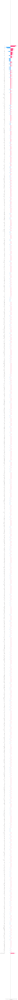

In [ ]:
shap.plots.bar(shap_values2.sum(0),max_display=1300)

In [ ]:
sample = shap_values2[:50]

f= plt.figure()
# plt.title('sample text plot(n=50)')
shap.plots.text(sample)
plt.tight_layout()
f.savefig('/content/drive/MyDrive/BA_capstone/bert_shap/sample_text_plot(n=50).png', format='png')

<Figure size 640x480 with 0 Axes>

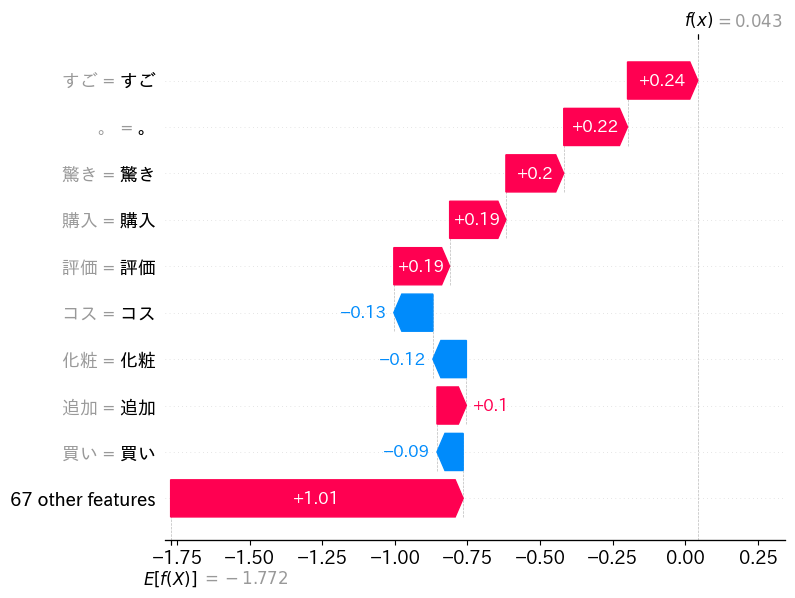

In [ ]:
shap.plots.waterfall(shap_values2[8])

# [부록] attention

In [ ]:
sample_data = next(iter(test_dataloader))
sample_data = {key: value.to(device) for key, value in sample_data.items()}

labels = sample_data["labels"]
output = model(**sample_data, output_attentions=True)
pred = output[1].argmax(axis=1)
attentions = output[2]

print(pred, labels)
print(type(attentions), len(attentions))
print(type(attentions[-1]), attentions[-1].shape)

tensor([1, 1, 1, 0, 1, 0, 1, 1], device='cuda:0') tensor([1, 1, 0, 0, 0, 1, 1, 1], device='cuda:0')
<class 'tuple'> 12
<class 'torch.Tensor'> torch.Size([8, 12, 200, 200])


In [ ]:
import textwrap

for batch_number in range(len(labels)):
  all_attens = attentions[-1][batch_number, :, 0, :].sum(axis=0)
  input_ids_index_list = all_attens.topk(20).indices
  text = tokenizer.convert_ids_to_tokens(sample_data["input_ids"][batch_number])
  for input_ids_index in input_ids_index_list:
    word = text[input_ids_index]
    text[input_ids_index] = '\033[34m' + text[input_ids_index] + '\033[0m'

  s_wrap_list = textwrap.wrap(''.join(text), 100)
  print(f"category: {category_list[labels[batch_number]]}")
  print('\n'.join(s_wrap_list), "\n")

category: 1
[CLS]ディオ##ールのエイ##ジング系のスキンケア結##構きになっていたのでサンプル当たって非常に嬉##しいです少し前に当選したのですが、載せ##るの
遅くなってしまいました。使用感が一度でわかりました。[
0mこれを使う前までさ##っぱ##り系の化粧水を使っていたので差が歴##然として分かりやす##かったです。と##ろ##みのあるロー##ションは肌な##じみがとっ##
て##も気持ちがよく、し##っっとり肌へ[UNK]シ##ミん##で滑らかでうる##お##いのある肌に整えてくれます。乳##液いらずと言った[34
m印象でした。香りはザ##デ##パ##コスな感じの高##貴な香りです。香##水のように香##るので、そのような香りに癒##されたい方にもオス##ス##メです
。香りがいいと毎日使う度う##っと##りして気分もあ##がります[SEP] 

category: 1
[CLS]香りに癒##されます。オイルが入ってるのか、洗い上がりもし##っと##りします。
週に一回使用なら、コスパもいい
と思います。[SEP][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD
][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD
][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD
][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD
][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD
][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD][PAD